# Police Brutality in the US Analysis

In [2]:
import pandas as pd
import numpy as np
import nltk
from itertools import combinations
from datetime import datetime as dt
from matplotlib import pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from urllib.request import urlopen
import json
import seaborn as sbs
from scipy.stats import pearsonr
from matplotlib.patches import Rectangle
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)
%matplotlib inline
plt.style.use('seaborn-v0_8')

### Table of Contents: 
* Data Prep & Feature Engineering
    * Police Brutality Data
    * US City Coordinates Data
    * US County Data
    * US Gun Laws Data
* Combined Analysis
* Conclusions
* Points of Improvement

## Data Prep & Feature Engineering

For this project I have decided to look at the police killings made by US Police Officers over the timespan 2015-2017. This analysis involves not only the original dataset provided by Kaggle "Fatal Police Shootings, 2015-Present", but several contextual datasets containing individual household cost & median income values of families by county (source: https://www.kaggle.com/datasets/asaniczka/us-cost-of-living-dataset-3171-counties) & US State legislature decisions on gun laws (source: https://www.kaggle.com/datasets/jboysen/state-firearms). Laslty, I include a dataset on US City coordinates & density values (source: https://www.kaggle.com/datasets/sergejnuss/united-states-cities-database). The following section explores, at least initially, these datasets alongside creating features that make sense for further analysis. 

Let's first pull in the US City Coordinates dataset.

### US City Coordinates 

We include the `county_fips`, value, which is a unique county code for US counties. We also change the `county_name` value to include the word "county" to later be able to merge the data into other tables.

In [3]:
us_cities_coord = pd.read_csv('Datasets/uscities.csv')
us_cities_coord = us_cities_coord[['city', 'county_name', 'state_id', 'county_fips', 'lat', 'lng', 'density']] 
us_cities_coord['county_fips'] = us_cities_coord['county_fips'].astype(str)
us_cities_coord['county_name'] = us_cities_coord['county_name']+" County"
us_cities_coord['county_fips'] = ("0" + us_cities_coord['county_fips']).where(us_cities_coord['county_fips'].str.len() < 5, us_cities_coord['county_fips'])
us_cities_coord.head()

,city,county_name,state_id,county_fips,lat,lng,density
0,New York,New York County,NY,36061,40.6943,-73.9249,10715
1,Los Angeles,Los Angeles County,CA,06037,34.1139,-118.4068,3276
2,Chicago,Cook County,IL,17031,41.8373,-87.6862,4574
3,Miami,Miami-Dade County,FL,12086,25.7839,-80.2102,5019
4,Dallas,Dallas County,TX,48113,32.7936,-96.7662,1526


In [4]:
print(f"Unique county names: {us_cities_coord.county_name.nunique()}")
print(f"Unique states: {us_cities_coord.state_id.nunique()}")
print(f"Unique states-counties: {us_cities_coord['county_fips'].nunique()}")

Unique county names: 1905
Unique states: 52
Unique states-counties: 3209


There are ~3 thousand unique state-county combinations within 52 states (or state-like entities, such as `Washington DC` & `Puerto Rico`)

### Police Brutality Data

In [5]:
brutality_data = pd.read_csv('Datasets/database.csv', parse_dates=True) 
del brutality_data['id']
brutality_data['date'] = pd.to_datetime(brutality_data['date'])
brutality_data['year'] = brutality_data['date'].dt.year
brutality_data.head()

,name,date,manner_of_death,armed,age,gender,race,city,state,signs_of_mental_illness,threat_level,flee,body_camera,year
0,Tim Elliot,2015-01-02,shot,gun,53.0,M,A,Shelton,WA,True,attack,Not fleeing,False,2015
1,Lewis Lee Lembke,2015-01-02,shot,gun,47.0,M,W,Aloha,OR,False,attack,Not fleeing,False,2015
2,John Paul Quintero,2015-01-03,shot and Tasered,unarmed,23.0,M,H,Wichita,KS,False,other,Not fleeing,False,2015
3,Matthew Hoffman,2015-01-04,shot,toy weapon,32.0,M,W,San Francisco,CA,True,attack,Not fleeing,False,2015
4,Michael Rodriguez,2015-01-04,shot,nail gun,39.0,M,H,Evans,CO,False,attack,Not fleeing,False,2015


Now let's merge the US county coordinate data into the brutality_data to enable further analysis

In [6]:
brutality_data = pd.merge(brutality_data, us_cities_coord, how = 'left', left_on = ['state', 'city'], right_on = ['state_id', 'city'])
del brutality_data['state_id']
brutality_data.head()

,name,date,manner_of_death,armed,age,gender,race,city,state,signs_of_mental_illness,threat_level,flee,body_camera,year,county_name,county_fips,lat,lng,density
0,Tim Elliot,2015-01-02,shot,gun,53.0,M,A,Shelton,WA,True,attack,Not fleeing,False,2015,Mason County,53045,47.2186,-123.1120,708.0
1,Lewis Lee Lembke,2015-01-02,shot,gun,47.0,M,W,Aloha,OR,False,attack,Not fleeing,False,2015,Washington County,41067,45.4920,-122.8726,2851.0
2,John Paul Quintero,2015-01-03,shot and Tasered,unarmed,23.0,M,H,Wichita,KS,False,other,Not fleeing,False,2015,Sedgwick County,20173,37.6896,-97.3442,931.0
3,Matthew Hoffman,2015-01-04,shot,toy weapon,32.0,M,W,San Francisco,CA,True,attack,Not fleeing,False,2015,San Francisco County,06075,37.7562,-122.4430,7256.0
4,Michael Rodriguez,2015-01-04,shot,nail gun,39.0,M,H,Evans,CO,False,attack,Not fleeing,False,2015,Weld County,08123,40.3660,-104.7389,804.0



What about the timespan of this dataset? How many months does it encompass?

In [7]:
print(brutality_data.date.agg({'min','max'}).sort_index(ascending = False))
brutality_data.groupby('year').date.count()

min   2015-01-02
max   2017-02-28
Name: date, dtype: datetime64[ns]


year
2015    991
2016    963
2017    188
Name: date, dtype: int64

The values range from `2015-01-02` to `2017-02-28`, which encompasses ~2 full years of fatal police shootings. From the distribution, we can also see that most of the police shootings happened during the years 2015-2016, and little in the year 2017, which matches up with the fact that 2017 only has a few months in the dataset.

In [8]:
print(f"Number of fatal police shootings 2015-2017: {brutality_data.date.count()}")
brutality_data.isna().sum()

Number of fatal police shootings 2015-2017: 2142


name                        19
date                         0
manner_of_death              0
armed                        6
age                         43
gender                       1
race                       103
city                         0
state                        0
signs_of_mental_illness      0
threat_level                 0
flee                        36
body_camera                  0
year                         0
county_name                239
county_fips                239
lat                        239
lng                        239
density                    239
dtype: int64

Looking at the number of `NA` values, we can already see that we have significant chunks of missing data in the `name`, `age`, `race` & `flee` columns within the original Fatal Police Shootings table, but an additional 239 `NA` values from the county coordinates data we tried to merge together. Having it represent 11.15% of our entire dataset is not ideal, but we will push on.

Let's look at these values and decide whether should we exclude these values:

In [9]:
brutality_data[brutality_data.race.isna()].head()

,name,date,manner_of_death,armed,age,gender,race,city,state,signs_of_mental_illness,threat_level,flee,body_camera,year,county_name,county_fips,lat,lng,density
59,William Campbell,2015-01-25,shot,gun,59.0,M,NaN,Winslow,NJ,False,attack,Not fleeing,False,2015,NaN,NaN,NaN,NaN,NaN
241,John Marcell Allen,2015-03-30,shot,gun,54.0,M,NaN,Boulder City,NV,False,attack,Not fleeing,False,2015,Clark County,32003,35.8407,-114.9257,30.0
266,Mark Smith,2015-04-09,shot and Tasered,vehicle,54.0,M,NaN,Kellyville,OK,False,attack,Other,False,2015,Creek County,40037,35.9482,-96.2143,376.0
340,Joseph Roy,2015-05-07,shot,knife,72.0,M,NaN,Lawrenceville,GA,True,other,Not fleeing,False,2015,Gwinnett County,13135,33.9523,-83.9931,874.0
398,James Anthony Morris,2015-05-31,shot,gun,40.0,M,NaN,Medford,OR,True,attack,Not fleeing,False,2015,Jackson County,41029,42.3372,-122.8537,1243.0


In [10]:
brutality_data[brutality_data.age.isna()].head()

,name,date,manner_of_death,armed,age,gender,race,city,state,signs_of_mental_illness,threat_level,flee,body_camera,year,county_name,county_fips,lat,lng,density
124,Alejandro Salazar,2015-02-20,shot,gun,NaN,M,H,Houston,TX,False,attack,Car,False,2015,Harris County,48201,29.7863,-95.3889,1399.0
658,Roger Albrecht,2015-08-29,shot,knife,NaN,M,W,San Antonio,TX,False,other,Not fleeing,False,2015,Bexar County,48029,29.4658,-98.5253,1231.0
707,Lawrence Price,2015-09-17,shot,gun,NaN,M,W,Brodhead,KY,False,attack,Not fleeing,False,2015,Rockcastle County,21203,37.4027,-84.4144,261.0
769,Jason Day,2015-10-12,shot,gun,NaN,M,B,Lawton,OK,False,attack,Not fleeing,False,2015,Comanche County,40031,34.6176,-98.4203,441.0
802,John Tozzi,2015-10-24,shot,gun,NaN,M,NaN,New Paltz,NY,False,attack,Not fleeing,False,2015,NaN,NaN,NaN,NaN,NaN


In [11]:
brutality_data[brutality_data.name.isna()].head()

,name,date,manner_of_death,armed,age,gender,race,city,state,signs_of_mental_illness,threat_level,flee,body_camera,year,county_name,county_fips,lat,lng,density
928,NaN,2015-12-10,shot,gun,NaN,M,NaN,Hemet,CA,False,attack,Not fleeing,False,2015,Riverside County,06065,33.7341,-116.9969,1125.0
1382,NaN,2016-05-26,shot,gun,NaN,M,NaN,San Antonio,TX,False,other,Not fleeing,False,2016,Bexar County,48029,29.4658,-98.5253,1231.0
1385,NaN,2016-05-26,shot,knife,NaN,F,NaN,Sneads,FL,False,other,Not fleeing,False,2016,Jackson County,12063,30.7085,-84.9249,156.0
1397,NaN,2016-06-01,shot,gun,NaN,M,NaN,Phoenix,AZ,False,attack,Not fleeing,False,2016,Maricopa County,04013,33.5722,-112.0891,1253.0
1419,NaN,2016-06-09,shot,baton,NaN,M,NaN,Somerton,AZ,False,attack,Not fleeing,False,2016,Yuma County,04027,32.6009,-114.6990,861.0


The only suspicious table with `NA` values is the one that has the names missing, which is also missing the `age` & `race` values. However, the amount of missing data points for this rows, in my opinion, is not significant enough to warrant removal of these rows from the dataset.

In [12]:
print(brutality_data.groupby('gender').date.count().sort_values(ascending=False))
print(brutality_data.groupby('age').date.count().nlargest(5).sort_values(ascending=False))
print(brutality_data.groupby('race').date.count().sort_values(ascending=False))

gender
M    2052
F      89
Name: date, dtype: int64
age
25.0    85
31.0    82
36.0    79
29.0    75
26.0    65
Name: date, dtype: int64
race
W    1041
B     542
H     367
A      33
N      28
O      28
Name: date, dtype: int64


Once we look at the number of rows split by the peoples' identifying metrics (their `name`, `age` & `race`), we can see some interesting findings. There are significantly more men killed than women that were killed & White people were killed the most in terms of race, followed by Black & Hispanic people. As for the most popular age, we can definitely see the victims being relatively young, with the most common age being 25. However, without further context, it is difficult to make any conclusions. 

Speaking of age, how many underaged victims do we have?

In [13]:
brutality_data[brutality_data.age < 18].age.count()

39

Tragically, there are 39 underaged victims from police shootings from 2015 to 2017.

One last things we should check against is the possibility of their being duplicate names in the dataset

In [14]:
print("Similar Name list:")

df = brutality_data[brutality_data.name.notnull()]

similar_names = []
names_comb = [*combinations(set(df.name), 2)]

for i, x in enumerate(names_comb):
    if x[0] != x[1] and int(nltk.edit_distance(x[0], x[1], transpositions = True)) < 3:# ~x.isin(similar_names) and ~y.isin(similar_names) and 
        print(f"{x[0]}, {x[1]}")
        similar_names.append(x[0])
        similar_names.append(x[1])

Similar Name list:


Michael Thompson, Michael  Thomason
Michael Johnson, Michael  Johnson
Dustin Kuik, Dustin Kirk
Dylan Papa, Dylan Pape
Robert Keil, Robert Kohl
Kim Jackson, Kris Jackson
Daniel Wolfe, Daniel Nole
Christopher Sowell, Christopher Shell
James Johnson, Jared Johnson


In [15]:
brutality_data[brutality_data.name.isin(similar_names)].sort_values('name')

,name,date,manner_of_death,armed,age,gender,race,city,state,signs_of_mental_illness,threat_level,flee,body_camera,year,county_name,county_fips,lat,lng,density
738,Christopher Shell,2015-09-27,shot,gun,43.0,M,W,Rossville,GA,False,attack,Not fleeing,False,2015,Walker County,13295,34.9747,-85.2898,857.0
1712,Christopher Sowell,2016-09-28,shot,undetermined,32.0,M,B,Philadelphia,PA,False,attack,Not fleeing,False,2016,Philadelphia County,42101,40.0077,-75.1339,4554.0
823,Daniel Nole,2015-10-30,shot and Tasered,knife,30.0,M,W,Norwood,OK,False,attack,Foot,False,2015,NaN,NaN,NaN,NaN,NaN
295,Daniel Wolfe,2015-04-21,shot,vehicle,35.0,M,B,Trenton,NJ,False,attack,Not fleeing,False,2015,Mercer County,34021,40.2236,-74.7641,4238.0
1942,Dustin Kirk,2016-12-27,shot,gun,35.0,M,NaN,Grass Valley,CA,False,attack,Not fleeing,False,2016,Nevada County,06057,39.2237,-121.0521,942.0
682,Dustin Kuik,2015-09-09,shot,gun,25.0,M,W,Ashwaubenon,WI,False,attack,Not fleeing,False,2015,Brown County,55009,44.4796,-88.0889,535.0
1663,Dylan Papa,2016-09-06,shot,sword,25.0,M,W,Phoenix,AZ,True,attack,Not fleeing,False,2016,Maricopa County,04013,33.5722,-112.0891,1253.0
1218,Dylan Pape,2016-03-21,shot,toy weapon,25.0,M,W,Stamford,CT,True,attack,Not fleeing,False,2016,Fairfield County,09001,41.1035,-73.5583,1330.0
417,James Johnson,2015-06-08,shot,gun,54.0,M,NaN,Beech Grove,IN,True,attack,Not fleeing,False,2015,Marion County,18097,39.7157,-86.0871,1288.0
319,Jared Johnson,2015-04-28,shot,gun,21.0,M,B,New Orleans,LA,False,attack,Not fleeing,True,2015,Orleans County,22071,30.0687,-89.9288,889.0


We find that there are actually significant amounts of very similar names that might have been typos, but looking at the supplementary data for the shootings, it's quickly apparent that even though the names of the people might be very similar, these are totally separate incidents. For example, the case of `Michael Johnson` & `Michael  Johnson` might seem that this is the same accident, but spelled with a mistake, the two shootings happened 3 weeks apart, in totally different cities & one had the policeman wearing a body_camera & the other - not wearing a body camera. Therefore, we validate that all occurences are unique & we do not remove any duplicate values.

What other information can we see from the original categorical variables?

In [16]:
print(f"Race unique values: {brutality_data.race.unique()}")
print(f"Manner of death unique values: {brutality_data.manner_of_death.unique()}")
print(f"Armed unique values: {brutality_data.armed.unique()}")
print(f"Signs of mental illness unique values: {brutality_data.signs_of_mental_illness.unique()}")
print(f"Threat Level unique values: {brutality_data.threat_level.unique()}")
print(f"Flee unique values: {brutality_data.flee.unique()}")
print(f"Body Camera values: {brutality_data.body_camera.unique()}")

Race unique values: ['A' 'W' 'H' 'B' 'O' nan 'N']
Manner of death unique values: ['shot' 'shot and Tasered']
Armed unique values: ['gun' 'unarmed' 'toy weapon' 'nail gun' 'knife' 'vehicle' 'shovel'
 'hammer' 'hatchet' 'undetermined' 'sword' 'machete' 'box cutter'
 'metal object' 'screwdriver' 'lawn mower blade' 'flagpole'
 'guns and explosives' 'cordless drill' 'crossbow' 'metal pole' 'Taser'
 'metal pipe' 'metal hand tool' 'blunt object' 'metal stick'
 'sharp object' 'meat cleaver' nan 'carjack' 'chain' "contractor's level"
 'unknown weapon' 'stapler' 'beer bottle' 'bean-bag gun'
 'baseball bat and fireplace poker' 'straight edge razor' 'gun and knife'
 'ax' 'brick' 'baseball bat' 'hand torch' 'chain saw' 'garden tool'
 'scissors' 'pole' 'pick-axe' 'flashlight' 'baton' 'spear' 'pitchfork'
 'hatchet and gun' 'rock' 'piece of wood' 'bayonet' 'pipe' 'glass shard'
 'motorcycle' 'metal rake' 'crowbar' 'oar' 'machete and gun' 'tire iron'
 'pole and knife']
Signs of mental illness unique val

Some interestings findings:
* There are 6 non-missing race values: 
    * A - Native American or Alaskan
    * W - White
    * H - Hispanic
    * B - Black or African American
    * O - Unknown
    * N - Not Hispanic or Latino
* People were either shot or tazered & shot.
* There have been quite a lot of self-defense weapons that the victims used, but surprisingly, even `staplers` & `toy guns` were categorized as weapons of self-defense for the victims.
* There is no threat level for "non-threatening", which is peculiau, because that would assume that all police shootings happened in some manner of self defense for the policeman.

P.s: These classifications come from the State of Kansas, Department for Children of Families document on "Instructions for Reporting Race, Ethnicity, Language Preference and Other Communication Media". (Abbreviation-List.pdf) 

Let's look at the most used self-defense weapons: 

In [17]:
def remove_borders():
    for spine in plt.gca().spines.values():
        spine.set_visible(False)

C:\Users\a128670\AppData\Local\Temp\ipykernel_25976\3459526160.py:10: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


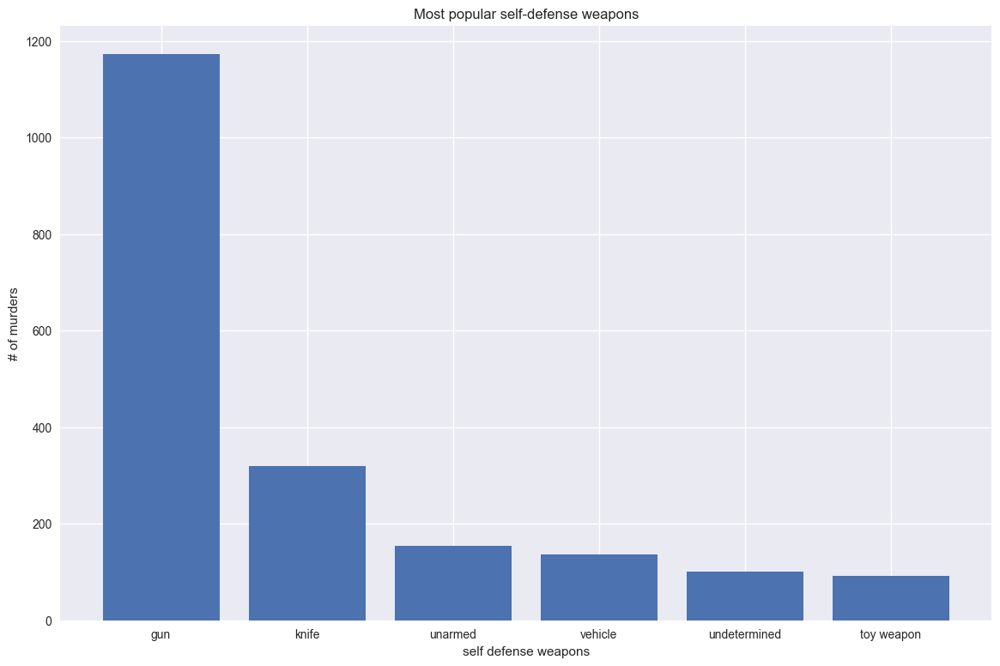

In [18]:
df = brutality_data.groupby('armed').date.count().nlargest(6)
fig = plt.figure(111, figsize=(14, 9))
bar1 = plt.bar(df.index, df.sort_values(ascending=False), label ='Armed')

remove_borders()
plt.ylabel('# of murders')
plt.xlabel('self defense weapons')
plt.title('Most popular self-defense weapons')

fig.show()

The most popular self-defense weapon for the victims were `guns` & `knives`. Another significant portion were `unarmed` & even `toy weapons` were in the top 6 of the weapons being wielded by the victims of the police shooting. This discovery could indicate a need for more precise measurement of the threat level that policemen are under when they pull the trigger, because if a victim were either unarmed, undetermined to be armed or wielding a toy weapon, that should hardly pose a significant threat to the policeman or surrounding people.

Having initially reviewed the original dataset values (both categorical & numeric), let's build a statistics table, that has the numbers summarized for each state as most of the analysis will be done by state level, rather than taking the US as a whole.

In [19]:
state_statistics = brutality_data.groupby('state').agg(
   killed = ("date", "count"),
   underaged_killed = ("age", lambda age : (age < 18).sum()),
   black_killed = ('race', lambda x: (x == 'B').sum()),
   white_killed = ('race', lambda x: (x == 'W').sum()),
   hispanic_killed = ('race', lambda x: (x == 'H').sum()),
   american_native_killed = ('race', lambda x: (x == 'A').sum()),
   n_killed = ('race', lambda x: (x == 'N').sum()),
   o_killed = ('race', lambda x: (x == 'O').sum()),
   na_race_killed = ('race', lambda x: (x.isna()).sum()),
   shot = ('manner_of_death', lambda x: (x=='shot').sum()),
   shot_tasered = ('manner_of_death', lambda x: (x=='shot and Tasered').sum()),
   mental_health_killed = ('signs_of_mental_illness', lambda x: (x).sum()),
   body_camera_uses = ('body_camera', lambda x: (x).sum()),
   armed_gun = ("armed", lambda arm : (arm =='gun').sum()),
   armed_knife = ("armed", lambda arm : (arm =='knife').sum()),
   unarmed = ("armed", lambda arm : (arm =='unarmed').sum()),
   armed_vehicle = ("armed", lambda arm : (arm =='vehicle').sum()),
   armed_undetermined = ("armed", lambda arm : (arm =='undetermined').sum()),
   armed_toy_weapon = ("armed", lambda arm : (arm =='toy weapon').sum()),
   armed_other = ("armed", lambda arm : (~arm.isin(['gun', 'knife', 'unarmed', 'vehicle', 'undetermined', 'toy weapon'])).sum()),
   age = ("age", 'mean'),
   women_perc = ("gender", lambda gndr : (gndr == 'F').sum() / gndr.count() * 100.0),
   men_perc = ("gender", lambda gndr : (gndr == 'M').sum() / gndr.count() * 100.0),
   white_perc = ("race", lambda race : (race == 'W').sum() / race.count() * 100.0),
   hispanic_perc = ("race", lambda race : (race == 'H').sum() / race.count() * 100.0),
   black_perc = ("race", lambda race : (race == 'B').sum() / race.count() * 100.0),
   american_native_perc = ("race", lambda race : (race == 'A').sum() / race.count() * 100.0),
   unknown_perc = ("race", lambda race : (race == 'O').sum() / race.count() * 100.0),
   n_perc = ("race", lambda race : (race == 'N').sum() / race.count() * 100.0),
   na_perc = ("race", lambda race : (race.isna()).sum() / race.count() * 100.0),
   shot_perc = ("manner_of_death", lambda mod : (mod == 'shot').sum() / mod.count() * 100.0),
#    shot_tasered_perc = ("manner_of_death", lambda mod : (mod == 'shot and Tasered').sum() / mod.count() * 100.0),
   attack_threat_lvl_perc = ("threat_level", lambda tlv : (tlv == 'attack').sum() / tlv.count() * 100.0),
   other_threat_lvl_perc = ("threat_level", lambda tlv : (tlv=='other').sum() / tlv.count() * 100.0),
   undeteremined_threat_lvl_perc = ("threat_level", lambda tlv : (tlv == 'undetermined').sum() / tlv.count() * 100.0),
   mental_illness_perc = ("signs_of_mental_illness", lambda tlv : (tlv).sum() / tlv.count() * 100.0),
   Car_fleeing_perc = ("flee", lambda fl : (fl == 'Car').sum() / fl.count() * 100.0),
   Foot_fleeing_perc = ("flee", lambda fl : (fl == 'Foot').sum() / fl.count() * 100.0),
   Not_fleeing_perc = ("flee", lambda fl : (fl == 'Not fleeing').sum() / fl.count() * 100.0),
   Other_fleeing_perc = ("flee", lambda fl : (fl == 'Other').sum() / fl.count() * 100.0),
   Body_camera_perc = ("body_camera", lambda bc : (bc).sum() / bc.count() * 100.0),
   ) 

state_statistics.head()

,killed,underaged_killed,black_killed,white_killed,hispanic_killed,american_native_killed,n_killed,o_killed,na_race_killed,shot,shot_tasered,mental_health_killed,body_camera_uses,armed_gun,armed_knife,unarmed,armed_vehicle,armed_undetermined,armed_toy_weapon,armed_other,age,women_perc,men_perc,white_perc,hispanic_perc,black_perc,american_native_perc,unknown_perc,n_perc,na_perc,shot_perc,attack_threat_lvl_perc,other_threat_lvl_perc,undeteremined_threat_lvl_perc,mental_illness_perc,Car_fleeing_perc,Foot_fleeing_perc,Not_fleeing_perc,Other_fleeing_perc,Body_camera_perc
state,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
AK,12,0,1,5,0,0,5,0,1,11,1,2,1,8,2,0,0,1,0,1,34.666667,8.333333,91.666667,45.454545,0.000000,9.090909,0.000000,0.000000,45.454545,9.090909,91.666667,83.333333,16.666667,0.000000,16.666667,16.666667,8.333333,75.000000,0.000000,8.333333
AL,44,2,12,30,0,0,0,0,2,41,3,11,11,27,1,2,4,1,4,5,38.558140,9.090909,90.909091,71.428571,0.000000,28.571429,0.000000,0.000000,0.000000,4.761905,93.181818,72.727273,20.454545,6.818182,25.000000,22.727273,11.363636,59.090909,6.818182,25.000000
AR,21,1,3,14,0,0,0,0,4,20,1,4,1,12,2,1,1,2,2,1,41.761905,0.000000,100.000000,82.352941,0.000000,17.647059,0.000000,0.000000,0.000000,23.529412,95.238095,52.380952,42.857143,4.761905,19.047619,5.000000,10.000000,85.000000,0.000000,4.761905
AZ,95,0,4,48,30,0,8,0,5,90,5,26,14,50,15,8,7,3,4,8,34.934066,8.421053,91.578947,53.333333,33.333333,4.444444,0.000000,0.000000,8.888889,5.555556,94.736842,62.105263,34.736842,3.157895,27.368421,18.085106,9.574468,70.212766,2.127660,14.736842
CA,355,8,60,103,145,14,0,8,25,321,34,86,47,134,85,32,25,25,15,39,34.776812,5.352113,94.647887,31.212121,43.939394,18.181818,4.242424,2.424242,0.000000,7.575758,90.422535,55.211268,36.901408,7.887324,24.225352,15.056818,12.215909,68.750000,3.977273,13.239437


Having this table opens up the possibility of looking at the number of shootings by state and other state characteristics:

The % of shootings that happened in the top 4 states, compared to the rest of the US: 36.23


C:\Users\a128670\AppData\Local\Temp\ipykernel_25976\2539497351.py:48: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


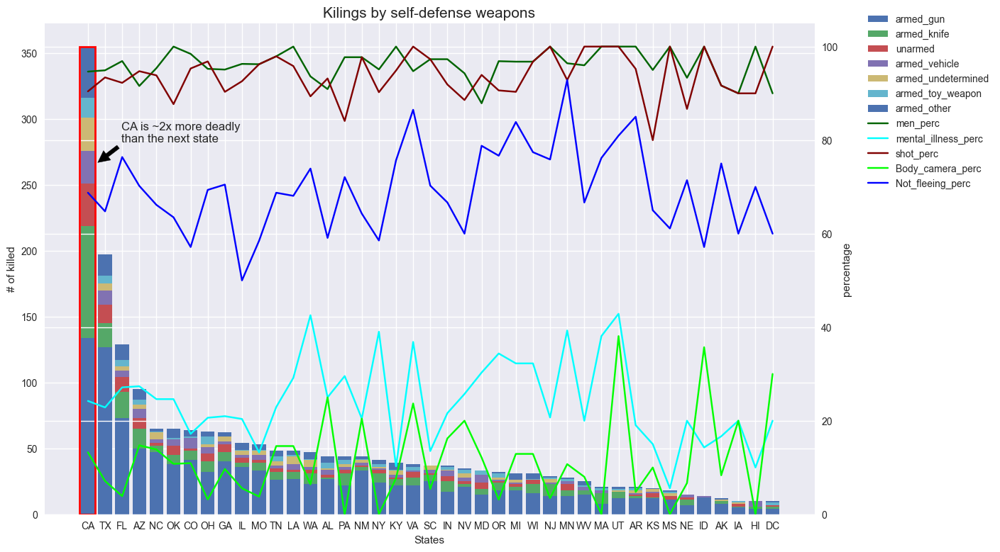

In [20]:
df = state_statistics[~state_statistics.index.isin([*state_statistics.killed.nsmallest(10).index])].sort_values('killed', ascending=False)
ss_columns = [*df.columns]
del ss_columns[0], ss_columns[1] 

print(f"The % of shootings that happened in the top 4 states, compared to the rest of the US: {round(sum(state_statistics.killed.nlargest(4)) / sum(state_statistics.killed) * 100, 2)}")

fig = plt.figure(figsize=(14, 9))

bars = []
height = 0
for col in ['armed_gun', 'armed_knife', 'unarmed', 'armed_vehicle', 'armed_undetermined', 'armed_toy_weapon', 'armed_other']:
    bar = plt.bar(df.index, df[col], bottom = height, label = col)
    height += df[col]
    bars.append(bar)

plt.xlabel('States')
plt.ylabel('# of killed')
ax2 = plt.twinx()
ax2.set_ylabel('percentage')
ax2.set_ylim([0, 105])
lns = []

colors = ['darkgreen','cyan','maroon','lime', 'blue']


for i, (col, color) in enumerate(zip(['men_perc', 'mental_illness_perc', 'shot_perc', 'Body_camera_perc', 'Not_fleeing_perc'], colors)):
    ln = ax2.plot(df.index, df[col], color = color,
                  label = col)
    lns += ln 

labels = ([l.get_label() for l in [*bars, *lns]])

fig.legend([*bars, *lns], labels, bbox_to_anchor=(0.95, 0.9),
          loc='upper left', borderaxespad=0, fontsize = 10);

plt.title('Kilings by self-defense weapons', fontsize = 15)

plt.annotate(
    text="CA is ~2x more deadly\nthan the next state",
    xy=(0.5, 75), 
            xytext=(0.1, 0.8), textcoords='axes fraction',
            va='top', ha='left',
            arrowprops=dict(facecolor='black', shrink=0.05),
    size = 12)
rectangle = Rectangle(xy=(-0.5, 0), width=0.93, height=100, 
                        edgecolor='r', fc='None', lw=2)
fig.gca().add_patch(rectangle)
fig.show()

In [21]:
print(f"Body Camera Use is only used in {round(state_statistics.Body_camera_perc.mean(), 2)} % of the police shootings that happen in the US, on average.")

Body Camera Use is only used in 12.41 % of the police shootings that happen in the US, on average.


This is quite eye-opening. We can see that the state that leads the US in terms of fatal police shootings is by far the state of `California`. With 355 people killed, it has almost 2x the amount of shootings in 2015-2017 than the second place `TX`, which has 197. The top 4 states share 36.23% of all police shootings in the years 2015-2017, suggesting a centralization of police brutality in `CA`, `TX`, `FL`, `AZ`. 

Worryingly, in `CA`, only around 13% of the shootings that ended in people being killed had policemen record the footage via Body cameras, leading to high risk possible conviction problems in court for the families of the victims. This trend is actually even worsens for the next 2 most deadly states. Generally, all states have quite a low body camera percentage for policemen. 

The same goes for victims having Mental health issues - less than half of the victims in each state had any mental illness recorded.

In terms of self-defense weapons used, it's clear that most victims were armed with guns, but there is significant variability in which weapons were mostly used for the other states. This highly likely reflects the variability in provisions for weapon possession state-by-state. 

Lastly, almost in each state, the victims were majority not fleeing the police.

What about the distributions of the other values by state?

### US County Data

Having done the initial per state analysis, it is clear to see that the shootings are both spread out in each state in the United States (hinting at there being a nation-wide systemic problem), but also is more centralized toward the states of `CA`, `TX`, `FL`, `AZ`. But what makes these states special? Why do so many shootings happen here? One potential explanation could be the fact that these states have very spread out distributions of family incomes, resulting in them being striken with inequality & friction between the social classes of the areas. Let's try to create an inequality metric for each state & county and see whether that could be a good predictor for the amount of people killed in each state. For this reason, I have found a dataset that holds a number of families sampled from US states and counties on their costs & the `median family income` of each area based on the Family Budget Calculator by the Economic Policy Institute (EPI).

In [22]:
us_city_data = pd.read_csv('Datasets/cost_of_living_us.csv', index_col=0)
us_city_data = us_city_data.dropna()
print(f"We have {us_city_data.state.nunique()} unique states")
us_city_data.head()

We have 51 unique states


,state,isMetro,areaname,county,family_member_count,housing_cost,food_cost,transportation_cost,healthcare_cost,other_necessities_cost,childcare_cost,taxes,total_cost,median_family_income
case_id,,,,,,,,,,,,,,
1,AL,True,"Montgomery, AL MSA",Autauga County,1p0c,8505.72876,3454.91712,10829.16876,5737.47984,4333.81344,0.0000,6392.94504,39254.0532,73010.414062
1,AL,True,"Montgomery, AL MSA",Autauga County,1p1c,12067.50240,5091.70788,11588.19288,8659.55640,6217.45896,6147.8298,7422.07836,57194.3256,73010.414062
1,AL,True,"Montgomery, AL MSA",Autauga County,1p2c,12067.50240,7460.20308,12361.77720,11581.63260,7075.65816,15824.6940,9769.56228,76141.0308,73010.414062
1,AL,True,"Montgomery, AL MSA",Autauga County,1p3c,15257.15040,9952.23924,13452.18600,14503.70760,9134.35620,18802.1892,13101.70320,94203.5328,73010.414062
1,AL,True,"Montgomery, AL MSA",Autauga County,1p4c,15257.15040,12182.21400,13744.59840,17425.78560,9942.36396,18802.1892,13469.21880,100823.5200,73010.414062


When we look at the `county` value we can recognize that the naming convention is not followed the same in each state compared the rest of the US. Let's switch the names to be the same. 

In [23]:
print("The 2 states that have differing names for \"county\" compared to the rest of the states:")
print(set(us_city_data[us_city_data['county'].str.contains('Borough')].state), "- Boroughs")
print(set(us_city_data[us_city_data['county'].str.contains('Parish')].state), "- Parishes")
print(set(us_city_data[us_city_data['county'].str.contains('Area')].state), "- Areas")

us_city_data['county'] = (us_city_data['county'].str.replace("Parish", "County")).where(us_city_data['county'].str.contains('Parish'), us_city_data['county'])
us_city_data['county'] = (us_city_data['county'].str.replace("Borough", "County")).where(us_city_data['county'].str.contains('Borough'), us_city_data['county'])
us_city_data['county'] = (us_city_data['county'].str.replace("Area", "County")).where(us_city_data['county'].str.contains('Area'), us_city_data['county'])
us_cities_coord['county_name'] = (us_cities_coord['county_name'].str.replace("ñ", "n")).where(us_cities_coord['county_name'].str.contains('ñ'), us_cities_coord['county_name'])

The 2 states that have differing names for "county" compared to the rest of the states:
{'AK'} - Boroughs
{'LA'} - Parishes
{'AK'} - Areas


In [24]:
def normalization_formula(x : pd.Series, normalize: bool = False) -> pd.DataFrame:
    x_std = np.std(x)
    x_mean = np.mean(x)
    x_normalized = x.apply(lambda y: (y - x_std) / x_mean)

    iqr = (x.quantile(0.75) - x.quantile(0.25))
    iqr_normalized = (x_normalized.quantile(0.75) - x_normalized.quantile(0.25))
    if normalize:
        return iqr_normalized
    return iqr

Let's add the unique county fips to this table, which will allow for easier merging with other tables

In [25]:
us_city_data = pd.merge(us_city_data, us_cities_coord[['state_id', 'county_name', 'county_fips']], how = 'left', left_on = ['state', 'county'], right_on = ['state_id', 'county_name']) 
# leftovers = us_city_data[us_city_data.county_fips.isna()]
del us_city_data['state_id']
us_city_data.head()

,state,isMetro,areaname,county,family_member_count,housing_cost,food_cost,transportation_cost,healthcare_cost,other_necessities_cost,childcare_cost,taxes,total_cost,median_family_income,county_name,county_fips
0,AL,True,"Montgomery, AL MSA",Autauga County,1p0c,8505.72876,3454.91712,10829.16876,5737.47984,4333.81344,0.0,6392.94504,39254.0532,73010.414062,Autauga County,01001
1,AL,True,"Montgomery, AL MSA",Autauga County,1p0c,8505.72876,3454.91712,10829.16876,5737.47984,4333.81344,0.0,6392.94504,39254.0532,73010.414062,Autauga County,01001
2,AL,True,"Montgomery, AL MSA",Autauga County,1p0c,8505.72876,3454.91712,10829.16876,5737.47984,4333.81344,0.0,6392.94504,39254.0532,73010.414062,Autauga County,01001
3,AL,True,"Montgomery, AL MSA",Autauga County,1p0c,8505.72876,3454.91712,10829.16876,5737.47984,4333.81344,0.0,6392.94504,39254.0532,73010.414062,Autauga County,01001
4,AL,True,"Montgomery, AL MSA",Autauga County,1p0c,8505.72876,3454.91712,10829.16876,5737.47984,4333.81344,0.0,6392.94504,39254.0532,73010.414062,Autauga County,01001


In [26]:
print(f"Number of counties in us_city_data: {us_city_data.groupby([us_city_data.state, us_city_data.county]).county.count().count()}")
print(f"Number of NA county_fips: {(us_city_data.county_fips.isnull().groupby([us_city_data.state, us_city_data.county]).sum() > 0).sum()}")
print(f"""Share missing: {round((us_city_data.county_fips.isnull().groupby([us_city_data.state, us_city_data.county]).sum() > 0).sum()
                        / us_city_data.groupby([us_city_data.state, us_city_data.county]).county.count().count()*100, 4)} %""")

Number of counties in us_city_data: 3142
Number of NA county_fips: 71
Share missing: 2.2597 %


However, there are quite a lot of counties that we were not able to match from the US city data (specifically 71 of them). However, seeing that it only represents ~2.3 % of the data & that most of the values are in `Alaska` & `Virginia`, we proceed with this in mind.

Now, there is a set metric for calculating inequality for an area based on household income, and that is the Gini Index. According to the World DataBank, the Gini Index is defined as a measurement for "the extent to which the distribution of income or consumption among individuals or households within an economy deviates from a perfectly equal distribution". The Gini Coefficient is calculated by measuring statistical dispersion of the value for income. One of the means of doing so is to calculate Intequartile range. But because this income data for different states, and thus each state can have wildly different income medians, we normalize the income. 

Additionally, due to the fact that we only have median county income and not individual family incomes, we will make the assumption that `total_cost` is a sufficient proxy for income. If that were not true and income were wildly different from costs, then it would either be unsustainable (as a lot of families would be bankrupt), or everyone would be rich (which is highly likely not the case). 

In [27]:
us_state_ineq = us_city_data.groupby('state').agg(
    total_cost_state_median = ('total_cost', 'median'),
    total_cost_state_iqr = ('total_cost', lambda x: x.quantile(0.75) - x.quantile(0.25)),
    total_cost_state_normalized_iqr = ('total_cost', lambda x: normalization_formula(x, True))
)

us_city_data = pd.merge(us_city_data, us_state_ineq, how = 'outer', on = 'state')
print(f"States with the most cost equality: {us_state_ineq.total_cost_state_normalized_iqr.nsmallest(5)}")
us_state_ineq.sort_values('total_cost_state_normalized_iqr', ascending = False).head()

States with the most cost equality: state
VT    0.358676
GA    0.383277
MS    0.392662
SC    0.396236
TN    0.414289
Name: total_cost_state_normalized_iqr, dtype: float64


,total_cost_state_median,total_cost_state_iqr,total_cost_state_normalized_iqr
state,,,
DC,130148.1360,74038.2873,0.615500
NY,94543.4244,57554.3508,0.569466
WY,90475.1136,47912.4726,0.568305
NE,79110.5916,41382.7848,0.536909
AK,85958.2500,45128.4432,0.525119


Most uneven family cost (read - income) distributions are in `DC`, followed by `NY`, `WY`, `NE` & `AK`, according to the `total_cost_state_normalized_iqr`, whereas the most equal are in `VT`, `GA`, `MS`, `SC` & `TN`.

Let's examine the same things but for `counties`. Note here that we can look into inter-county inequality (essentially how big is the spread in income inside the county) & inter-state inequality (how well-off is the count compared to the median state income). We calculate these in `county_iqr_normalized` & `county_state_median_ratio` respectively.


In [28]:
county_ineq = us_city_data.groupby(['state', 'county', 'county_fips']).agg(
    county_iqr = ('total_cost', lambda x: normalization_formula(x)),
    county_iqr_normalized = ('total_cost', lambda x: normalization_formula(x, True)),
    state_iqr = ('total_cost_state_iqr', "median"),
    state_iqr_normalized = ('total_cost_state_normalized_iqr', "median"),
    total_cost_state_median = ('total_cost_state_median', "median"),
    total_cost_county_median = ('total_cost', lambda x: x.median())).reset_index()


county_ineq['county_state_median_ratio'] = county_ineq.total_cost_county_median / county_ineq.total_cost_state_median

print(county_ineq[county_ineq.state == 'CA'].head().set_index('county').county_iqr_normalized.nlargest(5))
county_ineq[county_ineq.state == 'CA'].head().set_index('county').county_state_median_ratio.nlargest(5)

county
Calaveras County    0.528050
Amador County       0.518983
Butte County        0.511194
Alpine County       0.508907
Alameda County      0.476182
Name: county_iqr_normalized, dtype: float64


county
Alameda County      1.292495
Calaveras County    0.969496
Amador County       0.947577
Alpine County       0.938222
Butte County        0.923370
Name: county_state_median_ratio, dtype: float64

If we specifically look at `CA`, we can see that the most unequal counties are `Calaveras`, `Amador`, `Butte`, `Alpine` & `Alameda` - all located in the outskirts of San Francisco (where Silicon Valley is lcoated). In terms of inter-state, we can see that the same counties are placed, just in a different order, indicating how rich this area is compared to the rest of the state.

Having this table allows us to visually plot this inequality on a map:

In [29]:
def county_choropleth(dataset: str) -> None:
    fig = go.Figure()

    with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
        counties = json.load(response)

    if dataset == 'county_ineq':
        fig = px.choropleth(county_ineq, geojson=counties, locations='county_fips', color='county_state_median_ratio',
                                color_continuous_scale="Viridis",
                                scope="usa",
                                hover_data= ['state', 'county', 'state_iqr_normalized', 'county_state_median_ratio', 'county_iqr', 'county_iqr_normalized'],
                                width = 1600,
                                height = 800,
                                title = "County Inequality Metrics"
                                )
        fig.update_layout(margin={"r":0,"t":80,"l":0,"b":0})


        cols_county_ineq = [*county_ineq.columns]
        cols_county_ineq.remove('county')
        cols_county_ineq.remove('state')
        cols_county_ineq.remove('county_fips')

        buttons_county_chloropleth = []

        for i, col in enumerate(cols_county_ineq):
            df = county_ineq[f'{col}']
            button = dict(method='update',
                    label = col,
                    args=[{'z': [df]},
                        {'coloraxis.colorscale':'Viridis'},
                        {'text' : col}])
            buttons_county_chloropleth.append(button)


        fig.update_layout(updatemenus=[dict(active = 0, buttons=buttons_county_chloropleth),])
        fig.update_layout(coloraxis_colorbar_title_text = 'Value Scale')
        fig.show()
        
    elif dataset == 'county_statistics':
        fig = go.Figure()
        fig = px.choropleth(county_statistics, geojson=counties, locations='county_fips', 
                            color='county_state_median_ratio',
                                color_continuous_scale="Viridis",
                                #  range_color=(0, 1),
                                scope="usa",
                                #    hover_data= {'county_fips' : False,
                                #        'state' : False,
                                #        'county_name' : True,
                                #        'killed' : True,
                                #        'underaged_killed' : True,
                                #        'age' : True,
                                #        'state_iqr_normalized' : True,
                                #        'county_state_median_ratio' : True,
                                #        'county_iqr' : True,
                                #        'county_iqr_normalized' : True
                                #        },
                                width = 1600,
                                height = 800,
                                title = "County Police Brutality &  Inequality Metrics (2015-2017)"
                                )
        fig.update_layout(margin={"r":0,"t":80,"l":0,"b":0})


        cols_county_ineq = [*county_statistics.columns]
        cols_county_ineq.remove('county_name')
        cols_county_ineq.remove('state')
        cols_county_ineq.remove('county_fips')

        buttons_county_chloropleth = []

        for i, col in enumerate(cols_county_ineq):
            df = county_statistics[f'{col}']
            button = dict(method='update',
                    label = col,
                    args=[{'z': [df]},
                        {'coloraxis.colorscale':'Viridis'},
                        {'text' : col}])
            buttons_county_chloropleth.append(button)


        fig.update_layout(updatemenus=[dict(active = 0, buttons=buttons_county_chloropleth),])
        fig.update_layout(coloraxis_colorbar_title_text = 'Value Scale')
        fig.show()

county_choropleth('county_ineq')

If we select county_iqr as the metric to be shown, we can see the biggest metropolitan areas in the US being visibly lighter than the rural areas that are the darkest - that makes sense, the more metropolitan the area is, the more likely that high income earners live in the area for work and thus we see bigger IQRs in the counties.

But this data is not normalized, when we select `county_iqr_normalized`, we can see a different picture - the map suddenly becomes lighter, which makes sense as we are looking at relative incomes. In this instance, the midwest seems to be more inter-county unequal than the south & south west of the nation. There are also some strange outliers - like the 4 counties in ND, that have a lot of variability in family costs.

Filtering by state_iqr & `state_iqr_normalized` shows us that within-state inequality is most prevalent in the midwest, east coast, `New York` & `Wyoming` (very surprising). 

According to the cost medians, the priciest states & counties are: `San Mateo County` & `Marin County` in `CA` & `San Mateo County` & `Putnam County` in `NY` (for Counties). For states, `HI` & `MA` are the priciest.

Lastly, the `county_state_median_ratio` shows us the biggest metropolitan areas in the US. 

Note, most of `Alaska` is gone, because of the previously mentioned issues with missing data.

That is very interesting, let's incorporate the data into the `brutality_data` dataframe for easier combined analysis. 

In [30]:
brutality_data = pd.merge(brutality_data, county_ineq[['county_fips', 'county_iqr', 'county_iqr_normalized', 'state_iqr', 'state_iqr_normalized', 'county_state_median_ratio',
                                      'total_cost_state_median', 'total_cost_county_median']], how = 'left', on = 'county_fips')

print(f"Amount of shootings we could not link data of inequality to: {brutality_data.county_iqr.isna().sum()}")

Amount of shootings we could not link data of inequality to: 273


Again, we were not able to find 273 locations of the shootings in the inequality dataset, so that should be an improvement point for the analysis going further.

But now that we have county level statistics included into the original dataset, we can create a summary table of per_county statistics to provide valuable insights

In [31]:
county_statistics = brutality_data.groupby(['state', 'county_name', 'county_fips']).agg(killed = ("date", "count"),
                                                       underaged_killed = ("age", lambda age : (age < 18).sum()),
                                                       black_killed = ('race', lambda x: (x == 'B').sum()),
                                                       white_killed = ('race', lambda x: (x == 'W').sum()),
                                                       hispanic_killed = ('race', lambda x: (x == 'H').sum()),
                                                       american_native_killed = ('race', lambda x: (x == 'A').sum()),
                                                       n_killed = ('race', lambda x: (x == 'N').sum()),
                                                       o_killed = ('race', lambda x: (x == 'O').sum()),
                                                       na_race_killed = ('race', lambda x: (x.isna()).sum()),
                                                       shot = ('manner_of_death', lambda x: (x=='shot').sum()),
                                                       shot_tasered = ('manner_of_death', lambda x: (x=='shot and Tasered').sum()),
                                                       mental_health_killed = ('signs_of_mental_illness', lambda x: (x).sum()),
                                                       body_camera_uses = ('body_camera', lambda x: (x).sum()),
                                                       armed_gun = ("armed", lambda arm : (arm =='gun').sum()),
                                                       armed_knife = ("armed", lambda arm : (arm =='knife').sum()),
                                                       unarmed = ("armed", lambda arm : (arm =='unarmed').sum()),
                                                       armed_vehicle = ("armed", lambda arm : (arm =='vehicle').sum()),
                                                       armed_undetermined = ("armed", lambda arm : (arm =='undetermined').sum()),
                                                       armed_toy_weapon = ("armed", lambda arm : (arm =='toy weapon').sum()),
                                                       armed_other = ("armed", lambda arm : (~arm.isin(['gun', 'knife', 'unarmed', 'vehicle', 'undetermined', 'toy weapon'])).sum()),
                                                       age = ("age", 'mean'),
                                                       women_perc = ("gender", lambda gndr : (gndr == 'F').sum() / gndr.count() * 100.0),
                                                       men_perc = ("gender", lambda gndr : (gndr == 'M').sum() / gndr.count() * 100.0),
                                                       white_perc = ("race", lambda race : (race == 'W').sum() / race.count() * 100.0),
                                                       hispanic_perc = ("race", lambda race : (race == 'H').sum() / race.count() * 100.0),
                                                       black_perc = ("race", lambda race : (race == 'B').sum() / race.count() * 100.0),
                                                       american_native_perc = ("race", lambda race : (race == 'A').sum() / race.count() * 100.0),
                                                       unknown_perc = ("race", lambda race : (race == 'O').sum() / race.count() * 100.0),
                                                       n_perc = ("race", lambda race : (race == 'N').sum() / race.count() * 100.0),
                                                       na_perc = ("race", lambda race : (race.isna()).sum() / race.count() * 100.0),
                                                       shot_perc = ("manner_of_death", lambda mod : (mod == 'shot').sum() / mod.count() * 100.0),
                                                    #    shot_tasered_perc = ("manner_of_death", lambda mod : (mod == 'shot and Tasered').sum() / mod.count() * 100.0),
                                                       attack_threat_lvl_perc = ("threat_level", lambda tlv : (tlv == 'attack').sum() / tlv.count() * 100.0),
                                                       other_threat_lvl_perc = ("threat_level", lambda tlv : (tlv == 'other').sum() / tlv.count() * 100.0),
                                                       undeteremined_threat_lvl_perc = ("threat_level", lambda tlv : (tlv == 'undetermined').sum() / tlv.count() * 100.0),
                                                       mental_illness_perc = ("signs_of_mental_illness", lambda tlv : (tlv).sum() / tlv.count() * 100.0),
                                                       Car_fleeing_perc = ("flee", lambda fl : (fl == 'Car').sum() / fl.count() * 100.0),
                                                       Foot_fleeing_perc = ("flee", lambda fl : (fl == 'Foot').sum() / fl.count() * 100.0),
                                                       Not_fleeing_perc = ("flee", lambda fl : (fl == 'Not fleeing').sum() / fl.count() * 100.0),
                                                       Other_fleeing_perc = ("flee", lambda fl : (fl == 'Other').sum() / fl.count() * 100.0),
                                                       Body_camera_perc = ("body_camera", lambda bc : (bc).sum() / bc.count() * 100.0),
                                                       county_iqr = ("county_iqr", "median"),
                                                       county_iqr_normalized = ("county_iqr_normalized", "median"), 
                                                       state_iqr = ("state_iqr", "median"),
                                                       state_iqr_normalize = ("state_iqr_normalized", "median"),
                                                       total_cost_state_median = ("total_cost_state_median", "median"),
                                                       total_cost_county_median  = ("total_cost_county_median", "median"),
                                                       county_state_median_ratio = ("county_state_median_ratio", "median")
                                                       ).reset_index()
county_statistics.head()

C:\Users\a128670\AppData\Local\Temp\ipykernel_25976\328744016.py:24: RuntimeWarning:

invalid value encountered in scalar divide

C:\Users\a128670\AppData\Local\Temp\ipykernel_25976\328744016.py:25: RuntimeWarning:

invalid value encountered in scalar divide

C:\Users\a128670\AppData\Local\Temp\ipykernel_25976\328744016.py:26: RuntimeWarning:

invalid value encountered in scalar divide

C:\Users\a128670\AppData\Local\Temp\ipykernel_25976\328744016.py:27: RuntimeWarning:

invalid value encountered in scalar divide

C:\Users\a128670\AppData\Local\Temp\ipykernel_25976\328744016.py:28: RuntimeWarning:

invalid value encountered in scalar divide

C:\Users\a128670\AppData\Local\Temp\ipykernel_25976\328744016.py:29: RuntimeWarning:

invalid value encountered in scalar divide

C:\Users\a128670\AppData\Local\Temp\ipykernel_25976\328744016.py:30: RuntimeWarning:

divide by zero encountered in scalar divide

C:\Users\a128670\AppData\Local\Temp\ipykernel_25976\328744016.py:22: RuntimeWarning:

inv

,state,county_name,county_fips,killed,underaged_killed,black_killed,white_killed,hispanic_killed,american_native_killed,n_killed,o_killed,na_race_killed,shot,shot_tasered,mental_health_killed,body_camera_uses,armed_gun,armed_knife,unarmed,armed_vehicle,armed_undetermined,armed_toy_weapon,armed_other,age,women_perc,men_perc,white_perc,hispanic_perc,black_perc,american_native_perc,unknown_perc,n_perc,na_perc,shot_perc,attack_threat_lvl_perc,other_threat_lvl_perc,undeteremined_threat_lvl_perc,mental_illness_perc,Car_fleeing_perc,Foot_fleeing_perc,Not_fleeing_perc,Other_fleeing_perc,Body_camera_perc,county_iqr,county_iqr_normalized,state_iqr,state_iqr_normalize,total_cost_state_median,total_cost_county_median,county_state_median_ratio
0,AK,Anchorage County,02020,3,0,0,3,0,0,0,0,0,3,0,1,0,2,0,0,0,0,0,1,32.000000,0.000000,100.000000,100.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,100.000000,100.000000,0.000000,0.0,33.333333,33.333333,0.000000,66.666667,0.0,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,AK,Fairbanks North Star County,02090,3,0,0,0,0,0,2,0,1,2,1,0,1,3,0,0,0,0,0,0,26.666667,0.000000,100.000000,0.000000,0.0,0.000000,0.0,0.0,100.000000,50.0,66.666667,100.000000,0.000000,0.0,0.000000,33.333333,33.333333,33.333333,0.0,33.333333,52882.2600,0.566338,45128.4432,0.525119,85958.2500,96288.0348,1.120172
2,AK,Matanuska-Susitna County,02170,3,0,1,1,0,0,1,0,0,3,0,0,0,2,1,0,0,0,0,0,35.333333,33.333333,66.666667,33.333333,0.0,33.333333,0.0,0.0,33.333333,0.0,100.000000,66.666667,33.333333,0.0,0.000000,0.000000,0.000000,100.000000,0.0,0.000000,48977.0220,0.559395,45128.4432,0.525119,85958.2500,90150.7146,1.048773
3,AL,Baldwin County,01003,1,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,54.000000,0.000000,100.000000,100.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,100.000000,100.000000,0.000000,0.0,0.000000,0.000000,0.000000,100.000000,0.0,0.000000,45142.9284,0.570308,35593.2720,0.506870,73693.4292,81278.1270,1.102922
4,AL,Barbour County,01005,1,0,1,0,0,0,0,0,0,1,0,0,1,1,0,0,0,0,0,0,35.000000,0.000000,100.000000,0.000000,0.0,100.000000,0.0,0.0,0.000000,0.0,100.000000,100.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,100.0,100.000000,31823.3880,0.488200,35593.2720,0.506870,73693.4292,67488.0264,0.915794


Having this table opens up the possibility of looking at the same metrics of inequality by county and other county characteristics, but only filtered for the counties that have at least one row in the original `brutality_data` dataset:

In [32]:
county_choropleth('county_statistics')

### US Gun Laws

While the Inequality surely explains some of the numbers for fatal police shootings, a big question mark that I had was whether the number of gun laws/provisions or changes to the number of gun laws/provisions had any impact on the amount of people that were killed in the state. And especially, since seeing that most of the shootings happened with people wielding a gun, this elevates the importance of such an analysis for lawmakers to understand whether and which laws curb the amount of people that die in police shootings every year. In order for us to answer these questions, I include the "Firearms Provisions in US States" dataset from The State Firearm Laws, which has data on various firearm provisions for 50 US states from 1991-2017.

For our analysis, we will only be using the years 2014-2017 as the analytical timeframe fits the timeline of the original `brutality_data` time frame with an extra year in order to understand changes made to gun laws in 2015. 

Note, that the dataset did not have any state abbreviations, so an additional dataset was introduced that houses all US state abbreviations.

In [33]:
us_gun_laws = pd.read_csv('Datasets/raw_data.csv') 
us_gun_laws_codebook = pd.read_excel('Datasets/codebook.xlsx', index_col=3) 
us_state_abbreviations = pd.read_csv('Datasets/states.csv', index_col=0)
us_gun_laws = us_gun_laws[us_gun_laws['year'].isin([2014, 2015, 2016, 2017])]
us_gun_laws.head()

,state,year,age18longgunpossess,age18longgunsale,age21handgunpossess,age21handgunsale,age21longgunpossess,age21longgunsale,age21longgunsaled,alcoholism,alctreatment,amm18,amm21h,ammbackground,ammlicense,ammpermit,ammrecords,ammrestrict,assault,assaultlist,assaultregister,assaulttransfer,backgroundpurge,cap14,cap16,cap18,capaccess,capliability,capunloaded,capuses,ccbackground,ccbackgroundnics,ccrenewbackground,ccrevoke,college,collegeconcealed,danger,dealer,dealerh,defactoreg,defactoregh,drugmisdemeanor,dvro,dvrodating,dvroremoval,dvrosurrender,dvrosurrenderdating,dvrosurrendernoconditions,elementary,exparte,expartedating,expartesurrender,expartesurrenderdating,expartesurrendernoconditions,felony,fingerprint,gunshow,gunshowh,gvro,gvrolawenforcement,immunity,incidentall,incidentremoval,inspection,invcommitment,invoutpatient,junkgun,liability,lockd,locked,lockp,lockstandards,loststolen,magazine,magazinepreowned,mayissue,mcdv,mcdvdating,mcdvremovalallowed,mcdvremovalrequired,mcdvsurrender,mcdvsurrenderdating,mcdvsurrendernoconditions,mentalhealth,microstamp,nosyg,onefeature,onepermonth,opencarryh,opencarryl,opencarrypermith,opencarrypermitl,permit,permitconcealed,permith,permitlaw,personalized,preemption,preemptionbroad,preemptionnarrow,purge,recordsall,recordsallh,recordsdealer,recordsdealerh,registration,registrationh,reportall,reportallh,reportdealer,reportdealerh,residential,security,showing,stalking,statechecks,statechecksh,strawpurchase,strawpurchaseh,tenroundlimit,theft,threedaylimit,traffickingbackground,traffickingprohibited,traffickingprohibitedh,training,universal,universalh,universalpermit,universalpermith,violent,violenth,violentpartial,waiting,waitingh,lawtotal
1150,Alabama,2014,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,10
1151,Alaska,2014,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4
1152,Arizona,2014,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,11
1153,Arkansas,2014,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,11
1154,California,2014,0,1,0,1,0,0,0,1,0,1,1,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,0,1,1,1,0,1,1,1,1,1,0,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,0,0,1,0,1,0,1,0,1,0,1,0,1,1,0,1,0,1,1,1,0,0,1,1,1,1,1,1,1,1,0,1,1,1,0,1,1,0,0,0,1,1,1,1,1,1,1,0,0,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,100


In [34]:
us_gun_laws = pd.merge(us_gun_laws, us_state_abbreviations, how = 'left', left_on = ['state'], right_index = True).rename(columns = {'Abbreviation' : 'state_id'})

Assuming that all changes to the gun laws for US states are live from January 1st of the year they are enacted, we can get a view on how many gun laws were enacted/annulled year over year for each state. We can also generally get the number of gun laws that a state has already enacted before.


In [35]:
us_gun_laws_pivoted = pd.melt(us_gun_laws, id_vars = ['state_id', 'year', 'lawtotal'], var_name='law', value_name='bool_value').sort_values(['state_id', 'law', 'year'])

us_gun_laws_diffs = us_gun_laws.groupby(['state_id', 'year']).agg({"lawtotal" : "median"}).reset_index()
us_gun_laws_diffs['lawtotal_diff'] = us_gun_laws_diffs['lawtotal'] - us_gun_laws_diffs['lawtotal'].shift(1)

us_gun_laws_diffs.head()

,state_id,year,lawtotal,lawtotal_diff
0,AK,2014,4.0,NaN
1,AK,2015,4.0,0.0
2,AK,2016,4.0,0.0
3,AK,2017,4.0,0.0
4,AL,2014,10.0,6.0


In [36]:
gun_laws_codebooked = pd.merge(us_gun_laws_pivoted,
                        us_gun_laws_codebook[['Brief Description of Provision', 'Detailed Description of Provision']],
                        how = 'left', left_on='law', right_index=True).sort_values(['state_id', 'law', 'year'])


gun_law_totals = gun_laws_codebooked.groupby(['state_id', 'year']).lawtotal.median()


gun_laws_codebooked['lag_boolvalue'] = gun_laws_codebooked.bool_value.shift(1)

conditions = (gun_laws_codebooked.state_id == gun_laws_codebooked.state_id.shift(1)) \
    & (gun_laws_codebooked.law == gun_laws_codebooked.law.shift(1)) \
    & (gun_laws_codebooked.year == gun_laws_codebooked.year.shift(1) + 1) \
    & (gun_laws_codebooked.bool_value != gun_laws_codebooked.bool_value.shift(1))


gun_law_changes = gun_laws_codebooked[conditions].sort_values(['state_id', 'law', 'year'])

gun_law_changes = pd.merge(gun_law_changes, us_gun_laws_diffs, how = 'left', on = ['state_id', 'year'])

gun_law_changes.sort_values(['state_id', 'law'])

gun_law_changes['change_type'] = np.where(gun_law_changes.bool_value > gun_law_changes.lag_boolvalue, "Strictening", "Loosening")

gl_changes_grouped = gun_law_changes.groupby(['state_id','year']).agg(law_strictenings = ('change_type', lambda x: (x == 'Strictening').sum()),
                                                                          law_loosenings = ('change_type', lambda x: (x == 'Loosening').sum()),
                                                                          ).reset_index()

gun_law_totals_and_changes = pd.merge(gun_law_totals, gl_changes_grouped, on = ['state_id', 'year'], how = 'left').fillna(0)
gun_law_totals_and_changes.head()

,state_id,year,lawtotal,law_strictenings,law_loosenings
0,AK,2014,4.0,0.0,0.0
1,AK,2015,4.0,0.0,0.0
2,AK,2016,4.0,0.0,0.0
3,AK,2017,4.0,0.0,0.0
4,AL,2014,10.0,0.0,0.0


In [37]:
print(f"Most gun law strict states (2015-2017):\n{gun_law_totals_and_changes.groupby('state_id').agg({'lawtotal' : 'median'}).lawtotal.nlargest(5)}")
print(f"Most gun law loose states (2015-2017):\n{gun_law_totals_and_changes.groupby('state_id').agg({'lawtotal' : 'median'}).lawtotal.nsmallest(5)}")
print(f"Most law strictenings states (2015-2017):\n{gun_law_totals_and_changes.groupby('state_id').agg({'law_strictenings' : 'sum', 'law_loosenings' : 'sum'}).law_strictenings.nlargest(5)}")
print(f"Most law loosening states (2015-2017):\n{gun_law_totals_and_changes.groupby('state_id').agg({'law_strictenings' : 'sum', 'law_loosenings' : 'sum'}).law_loosenings.nlargest(5)}")

Most gun law strict states (2015-2017):
state_id
CA    103.0
MA    100.0
CT     86.5
HI     77.5
NY     75.0
Name: lawtotal, dtype: float64
Most gun law loose states (2015-2017):
state_id
AK    4.0
MT    4.0
ID    4.5
MS    5.0
SD    5.0
Name: lawtotal, dtype: float64
Most law strictenings states (2015-2017):
state_id
OR    11.0
NV    10.0
NJ     8.0
CA     6.0
CT     5.0
Name: law_strictenings, dtype: float64
Most law loosening states (2015-2017):
state_id
AL    4.0
WV    3.0
ID    2.0
MO    2.0
TN    2.0
Name: law_loosenings, dtype: float64


Interestingly, we can see that most strict states in terms of gun laws are `CA`, `MA`, `CT`, `HI` & `NY`. That somewhat matches up with the most deadly states in terms of police shootings (think `CA`) or the most rich states (think `NY`, `HI`, `MA`). 
Quite interestingly, even though these rich states have a lot of gun provisions, they do not really suffer that much from fatal police shootings as we saw from the graph under the section "Police Brutality Data", which means that these states are somewhat preemptively cautious about gun-related problems within their territory.

In terms of states with loose gun law provisions, we can see that `AK`, `MT`, `ID`, `MS`, `SD` have the least amount of gun laws. The interesting bit is that these states didn't suffer from many fatal police shootings during the analysis time span, which leads us to believe that the relationship between gun law provisions & police shootings is reversed - the number of police shootings invokes increases in the number of gun law provisions passed by the state. And that the gun law provisions are to curb people from buying firearms that would allow them to do gun-bearing crimes for which police would end up in a shoot out. This at least to some extent makes sense in the grand scheme of things - the less guns = the less possibility for people to be threatening to the police = the less there are shootings.

What about the fastest movers in terms of gun laws throughout the analysis period? 

`OR`, `NV`, `NJ`, `CA` & `CT` were all rapidly and actively curbing gun possession during 2015-2017. For all of these states the biggest amount of self-defense weapons used in fatal police shootouts were guns. But more interesting is the fact that all these states are either on the west coast of the US (`CA`, `NV`, `OR`) or are the close to the biggest metropolitan areas in the United States (`CT` & `NJ` - next to New York city). This might be a strech, but these areas are known for having massive drug/drug cartel problems (especially on the west coast) and coupled with the fact that New York & California already being a part of the most restricted states in terms of gun laws, there might be shift of crime increasing from these metropolitan areas to their closest neighbours, which is forcing these surrounding states to catch up in terms of gun provisions. That would explain the passed laws in `OR`, `NV`, `NJ` & `CT`.  

Talking about the most provision-loosening stats, they are - `TN`, `MO`, `ID`, `WV` & `AL`, which are mostly rural, farming-based states. This leads us to conclude that most gun laws are actually enacted in states with the largest metropolitan areass.

Following the same logic, let's split the states into 5 bins based on the amount of gun laws they are have currently enacted & add it to the `state_statistics` table.

In [38]:
state_gun_law_totals = gun_law_totals_and_changes.groupby('state_id').agg(lawtotal_median = ("lawtotal", "median"),
                                                                          total_law_strictenings = ("law_strictenings", "sum"),
                                                                          total_law_loosenings = ("law_loosenings", "sum"))

state_category_gun_laws = pd.qcut(state_gun_law_totals.lawtotal_median, 5, labels=['Close to Unregulation',
                                                                                        'Slightly regulated',
                                                                                        'Averagely regulated',
                                                                                        'Strongly regulated',
                                                                                        'Strong regulation']).rename("gun_law_category")

state_gun_law_totals = pd.merge(state_gun_law_totals, state_category_gun_laws, how = 'outer', left_index = True, right_index= True)

state_statistics = pd.merge(state_statistics, state_gun_law_totals, how = 'left', left_index = True, right_index= True)
state_statistics[[*state_gun_law_totals.columns]].head(5)

,lawtotal_median,total_law_strictenings,total_law_loosenings,gun_law_category
state,,,,
AK,4.0,0.0,0.0,Close to Unregulation
AL,10.0,4.0,4.0,Slightly regulated
AR,11.0,0.0,0.0,Slightly regulated
AZ,11.0,0.0,0.0,Slightly regulated
CA,103.0,6.0,0.0,Strong regulation


In [39]:
print(f"Amount of states that do not have allocated a gun_law_category, because of no data on gun law provisions: {state_statistics.gun_law_category.isna().sum()}")

Amount of states that do not have allocated a gun_law_category, because of no data on gun law provisions: 1


Let's look at the distribution of these states based on the number of gun laws they have enacted:

C:\Users\a128670\AppData\Local\Temp\ipykernel_25976\3788071188.py:47: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



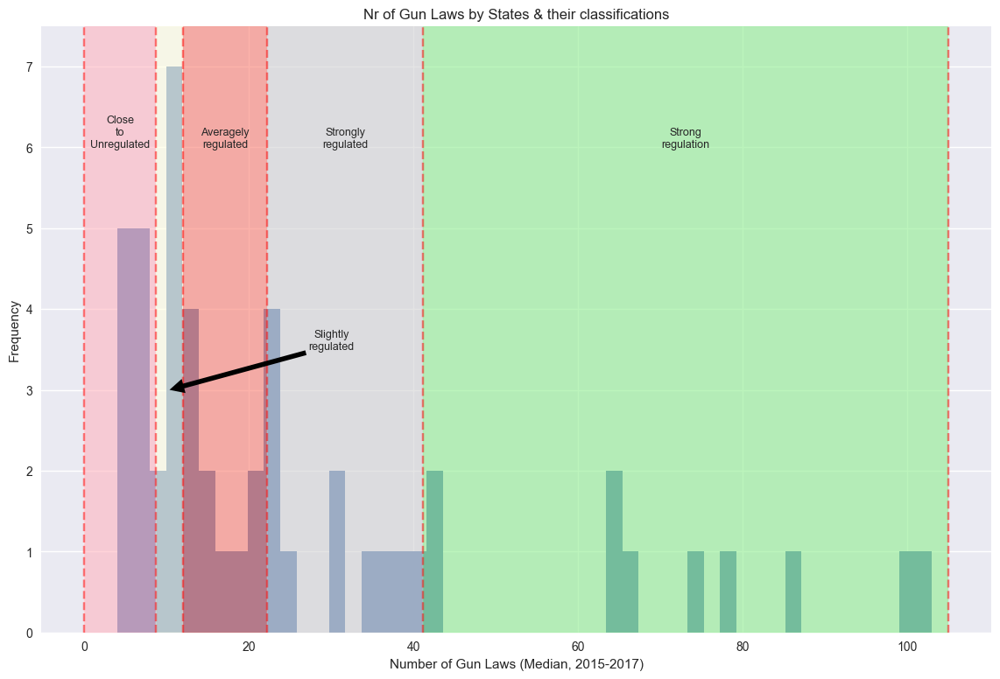

In [40]:
df, bins  = pd.qcut(state_gun_law_totals.lawtotal_median, 5,  retbins = True)

fig = plt.figure(figsize = (14, 9))
ax = state_gun_law_totals.lawtotal_median.plot.hist(bins=50)
ax.set_ylim([0, 7.5])
color = ['lightpink', 'lightyellow', 'salmon', 'lightgray', 'lightgreen']

bins[0] = 0
bins[5] = 105

for bin in bins:
    plt.axvline(x = bin, color = 'red', linestyle = '--', alpha = 0.5)

for cat, color in zip(range(0, len(bins)-1), color):
    ax.fill_between(x = bins[cat : cat+2],y1 = 7.5, color = color, alpha = 0.6)

labels=['Close\nto\nUnregulated',
        'Slightly\nregulated',
        'Averagely\nregulated',
        'Strongly\nregulated',
        'Strong\nregulation']

remove_borders()
for i, lbl in enumerate(labels):
    bin_min = bins[i]
    bin_max = bins[i+1]
    midpoint = bin_min + (bin_max - bin_min) / 2
    height = 3.5
    if lbl == 'Slightly\nregulated':
        plt.annotate(text = lbl,
                 xy = (midpoint, 3),
                 arrowprops=dict(facecolor='black', lw = 0.001, ls = '--'),
                 xytext = (30, 3.5),
                 fontsize = 9,
                 ha = 'center'
                 )
    else:
        plt.annotate(text = lbl,
                     xy= (midpoint, 6),
                     xytext= (midpoint, 6),
                     fontsize = 9,
                     ha = 'center'
                 )

plt.title('Nr of Gun Laws by States & their classifications')
plt.xlabel('Number of Gun Laws (Median, 2015-2017)')
fig.show()


The most amount of states seem to be clustered on around the 10-20 range, but there are some states that have more than 100 gun laws enacted. That is why they first three categories of states are so bunched together to the left. 

Let's add these values to the `brutality_data` table as well: 

In [41]:
brutality_data = pd.merge(brutality_data, state_gun_law_totals, how ='left', left_on = 'state', right_index = True)

print(f"The number of fatal shootings that happened in states with no data on gun provisions: {brutality_data['gun_law_category'].isna().sum()}.\n\
These states are: {brutality_data[brutality_data['gun_law_category'].isna()].state.unique()}")

The number of fatal shootings that happened in states with no data on gun provisions: 10.
These states are: ['DC']


Let's also quickly create a table that summarizes all murders that happened in each state per year & add the changes to the gun laws to that table as well

In [42]:
state_year_killings = brutality_data.groupby(['state', 'year']).agg(killed = ('name', 'count'),
                                            underaged_killed = ('age', lambda x: (x < 18).sum()),
                                            black_killed = ('race', lambda x: (x == 'B').sum()),
                                            white_killed = ('race', lambda x: (x == 'W').sum()),
                                            hispanic_killed = ('race', lambda x: (x == 'H').sum()),
                                            american_native_killed = ('race', lambda x: (x == 'A').sum()),
                                            n_killed = ('race', lambda x: (x == 'N').sum()),
                                            o_killed = ('race', lambda x: (x == 'O').sum()),
                                            na_race_killed = ('race', lambda x: (x.isna()).sum()),
                                            shot = ('manner_of_death', lambda x: (x=='shot').sum()),
                                            shot_tasered = ('manner_of_death', lambda x: (x=='shot and Tasered').sum()),
                                            mental_health_killed = ('signs_of_mental_illness', lambda x: (x).sum()),
                                            body_camera_uses = ('body_camera', lambda x: (x).sum()),
                                            ).reset_index()

state_year_killings = pd.merge(state_year_killings, gl_changes_grouped, how = 'left', left_on = ['state', 'year'], right_on = ['state_id', 'year'])
del state_year_killings['state_id']
state_year_killings.head()

,state,year,killed,underaged_killed,black_killed,white_killed,hispanic_killed,american_native_killed,n_killed,o_killed,na_race_killed,shot,shot_tasered,mental_health_killed,body_camera_uses,law_strictenings,law_loosenings
0,AK,2015,4,0,0,2,0,0,2,0,0,4,0,0,0,NaN,NaN
1,AK,2016,7,0,0,3,0,0,3,0,1,6,1,2,1,NaN,NaN
2,AK,2017,1,0,1,0,0,0,0,0,0,1,0,0,0,NaN,NaN
3,AL,2015,17,1,6,11,0,0,0,0,0,16,1,8,3,4.0,4.0
4,AL,2016,24,1,6,17,0,0,0,0,2,24,1,2,8,NaN,NaN


What about which gun laws are the most popular? 

Most Used Laws:
0                                                                                                                   Permit required to carry concealed weapons
1                                                                                                   Concealed carry permit process requires a background check
2                                                                                               Concealed carry permit renewal requires a new background check
3                                                                                         Firearm possession is prohibited for people with a felony conviction
4                                                                       Authorities are required to revoke concealed carry permits under certain circumstances
5                                                                        No gun carrying on elementary school property, including concealed weapons permittees
6    People convicted of a mis

C:\Users\a128670\AppData\Local\Temp\ipykernel_25976\428785062.py:14: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



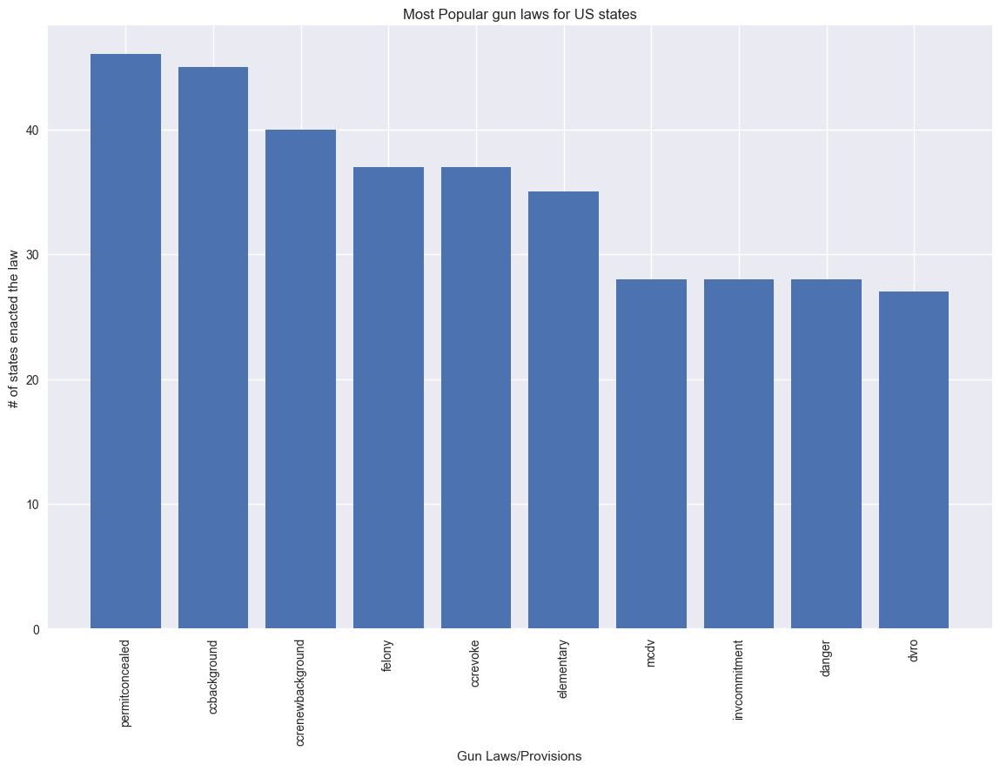

In [43]:
law_popularity = gun_laws_codebooked[gun_laws_codebooked.bool_value == 1].groupby(['law', 'Brief Description of Provision']).agg(count = ("state_id", "nunique")).sort_values("count", ascending= False).reset_index()
law_popularity.head()

df = law_popularity.nlargest(10, columns = ['count'])
fig = plt.figure(111, figsize=(14, 9))
bar1 = plt.bar(df.law, df['count'], label ='Most Common gun laws')

remove_borders()
plt.ylabel('# of states enacted the law')
plt.xlabel('Gun Laws/Provisions')
plt.title('Most Popular gun laws for US states')
plt.xticks(rotation = 90)

fig.show()
print(f"Most Used Laws:\n{df['Brief Description of Provision']}")

The most common US gun laws that more than 40 US states have enacted were `Permit required to carry concealed weapons` & `Concealed carry permit process requires a background check`. In the top 10 most popular laws, 4 regard some sort of permit that the person must hold in order for them to be able to carry the gun, 5 are related to provisions of selling weapons to people with questionable backgrounds & 1 is related with carrying weapons inside specific areas. Note as well how some laws are unspecified and can lead to some misunderstanding issues (e.g. `Authorities are required to revoke concealed carry permits under certain circumstances`)


Interestingly, when we look at the differences between the laws enacted in the top 5 deadliest states & compare it to the list of laws that were enacted in the top 5 least deadly states, there are no laws that are present in the safest states that are not present in the deadliest. This hints at the fact that most likely there are other systemic issues that point to the reason that there are high numbers of fatal police shootings & implementing laws alone, without the further context of intra-state workings, those copy-paste laws struggle to work. 

In [44]:
least_deadly_states = state_statistics.killed.nsmallest(5).index
most_deadly_states = state_statistics.killed.nlargest(5).index

state_law_counts = gun_laws_codebooked[gun_laws_codebooked.bool_value == 1].groupby(['state_id', 'law', 'Brief Description of Provision']).agg(years_active = ("year", "count")).reset_index()

least_deadly_states_laws = pd.Series(state_law_counts[state_law_counts.state_id.isin([*least_deadly_states])]['law'].unique(), name = 'laws')

most_deadly_states_laws = pd.Series(state_law_counts[state_law_counts.state_id.isin([*most_deadly_states])]['law'].unique(), name = 'laws')

merged = pd.merge(most_deadly_states_laws, least_deadly_states_laws, how = "left", indicator=True, on = 'laws')

print(merged[merged['_merge'] == 'right_only']['laws'])

Series([], Name: laws, dtype: object)


## Combined Datasets Analysis

Now that we have the initial dataset analysis covered, we will move to analyzing the entire dataset as a whole. 

Let's start by looking at the per state statistics that we haven't looked at previously:

In [45]:
fig = go.Figure()

fig = px.choropleth(data_frame=state_statistics,
                locations = state_statistics.index,
                locationmode="USA-states",
                color = 'killed',
                scope = "usa",
                hover_data = state_statistics.columns,
                title = 'State Statistic Distributions for US States',
                width = 1500,
                height = 700)

fig.update_layout(margin={"r":5,"t":80,"l":5,"b":0})

buttons_chloropleth = []

for i, col in enumerate(state_statistics.columns):
    df = state_statistics[f'{col}']
    button = dict(method='update',
            label = col,
            args=[{'z': [df]},
                {'coloraxis.colorscale':'Viridis'},
                {'text' : col}])
    buttons_chloropleth.append(button)


fig.update_layout(updatemenus=[dict(active = 0, buttons=buttons_chloropleth)])
fig.update_layout(coloraxis_colorbar_title_text = 'Value Scale')

fig.show()

Some interesting findings, that we haven't pointed out previously:
* Almost all underaged victims of police shootings happen in `California` (8 in 2015-2017), which is double the next deadliest state - `Florida`
* Most African American people were killed in `CA`, `FL` & `TX`.
* Most White people were killed in `CA` & `TX`. Actually, almost all of them centralized into the south east of the country.
* Most Native American people were killed in `CA`.
* Most Racially Unknown people were killed in `AZ`. This could be a symptom of the Mexican illegal immigrant problem. If people illegal immigrants are shot while illegally crossing the border, then their races might not be detected. Curiously, for some reason 5 hispanic people were killed in `Alaska` & 4 in `Washington` during 2015-2017. 
* Most Non-Hispanic people were killed in `CA` & `TX`.
* Most kills where people were shot happened in `CA`, `TX` & `FL`. But this trend is somewhat visible in the South East of the country. 
* Most kills where the police or civilians were `attacked` (% of all murders) happened in `RI` & `SD`. But this trend is somewhat more visible in the East of the country (except for New England).
* On the other hand, most kills where the police or civilians were under `other` threat level (% of all murders) happened in New England, specifically `NH`.
* Most kills where the police or civilians were under an `undetermined` threat level (% of all murders) happened in `ND` & `VT`.
* Almost 100% of the fatal police shootings in `VT` were of people that had mental health disorders.
* Almost 100% of the fatal police shootings in `VT` had the police wearing body cameras. All other states have a way lower number.
* States that have the strictest gun laws: `CA`, `MA`, `CT`, `IL`, `NY`, `MD`, `HI` & `NJ`.
* States that have the strictest gun laws: `MT`, `ID`, `SD`, `MS`, `GA`, `VT` & `KY`.
* States that during 2015-2017 strictened their gun provisions the most: `CA`, `OR`, `NV`.
* States that during 2015-2017 loosened their gun provisions the most: `AL`, `WV`, `TX`.

Alright, now let's try and looking at the distribution of different numeric metrics by categorical values just to see if we can unearth some significant findings (starting off with county density v gender):  

In [46]:
def create_geo_scatter(variable: str, splitter : str) -> None:
    
   df = brutality_data[~brutality_data[variable].isna() & brutality_data[splitter].notnull()].reset_index()
   
   q98 = df[variable].quantile(0.98)
   q02 = df[variable].quantile(0.02)
   df = df[(df[variable] < q98) & (df[variable] > q02)]
   fig = go.Figure()
   if splitter in ('gender|manner_of_death|year|threat_level|body_camera|signs_of_mental_illness'):
      fig = px.scatter_geo(df,
                     lat = df.lat, lon = df.lng,
                     locationmode="USA-states",
                     scope = 'usa',
                     color = df[variable],
                     facet_col = df[splitter],
                     color_continuous_scale="portland",
                     template = 'presentation',
                     hover_data = {"lat" : False,
                                 "lng" : False, 
                                 "gender" : False,
                                 "name" : True,
                                 "race" : True,
                                 "age" : True,
                                 "manner_of_death" : True, 
                                 "city" : True,
                                 "state" : True},
                     width = 1900,
                     height = 800,
                     title = f'US Police Killings by {splitter} (2015-2017)'
                     )
      # text_value = 'Note: 239 observations were excluded due to not being able to find coordinate data'
      b_value= 0

   else:
      fig = px.scatter_geo(df,
                     lat = df.lat, lon = df.lng,
                     locationmode="USA-states",
                     scope = 'usa',
                     color = df[variable],
                     facet_row = df[splitter],
                     color_continuous_scale="portland",
                     template = 'presentation',
                     hover_data = {"lat" : False,
                                 "lng" : False, 
                                 "gender" : False,
                                 "name" : True,
                                 "race" : True,
                                 "age" : True,
                                 "manner_of_death" : True, 
                                 "city" : True,
                                 "state" : True},
                     width = 1000,
                     height = 1800,
                     title = f'US Police Killings by {splitter} (2015-2017)'
                     )
      # text_value = """Note: 256 observations<br>were excluded due<br>to not being<br>able to find coordinates."""
      b_value = 0
   

   fig.for_each_annotation(lambda a: a.update(text = a.text.split("=")[1]))

   fig.update_layout(margin={"r":0,"t":80,"l":0,"b":b_value})
   fig.update_layout(coloraxis_colorbar_title_text = f'{variable}')

   fig.show()

In [47]:
create_geo_scatter('density', 'gender')

While there seems to be no difference between where men and women die from police shootings, it is evident that most of the shootings happen in comparatively rural areas with less population density. Another key point is that it seems that the midwest of the country is rather sparsely populated with dots, however that might be due to these states being less inhabited and more centralized towards the lone cities that are present in those states (e.g. `Nevada` with `Las Vegas`). Therefore, less people mean less potential police shootings that happen.

What about if we split the data by race?

In [48]:
create_geo_scatter('density', 'race')

Again, the results seem to be the same - most shootings happen in rather rural areas (at least compared to `San Francisco` & `New York`). However, there are some very interesting findings: 
* Most American Native victims semme to be very dispersed throughout the entire nation, which leads us to believe that these locations might be reservations or near reservations, where Native Americans currently live. 
* Majority of the police shooting victims are White (at least in the year 2015-2017) and they are dispersed throughout the entire country.
* Majority if Hispanic victims of police shootings happen around the South of the country, which most likely reflects the demographics of the South being next to the Mexican border and thus having a lot of Mexican immigrants. 
* Most African American or Black victim shootings happen in the South Eastern states of the country & California. This might be because more African Americans live in this side of the country.
* Unknown & Not Hispanic murders do not really display a specific trend, that is visible to the eye. 

What if we take a look at the county IQR values instead of the density?

In [49]:
create_geo_scatter('county_iqr_normalized', 'race')

Interestingly, there is a lot of variety in the results. Where we could at the start distinguish a line between areas where different race people would die in mostly the same areas, here we can see that, e.g. even though still majority of killings of African American people happen in the South-East of the country, the counties they were killed in, seemed to portray a lot of variability in terms of income inequality. The same thing can be said for every race. The defining factor here is that the areas that have red-ish dots are mostly metropolitan areas/cities, which are more prevalent in the fatal police shootings of White & Black people compared to Hispanic or Native American victims. This might reflect the fact that White people generally live better off than their Black counterparts & not the fact that police shootings specifically happen in areas that are more diverse in terms of family incomes for the white police shootings. 

In general, it seems that inter-county income inequality and race as a correlation does not seem to work as much, because we see most income inequality values for all victim races.

But what if we split this by the `manner of death` of the victim?

In [50]:
create_geo_scatter('county_iqr_normalized', 'manner_of_death')

From this we can clearly see that police shootings where people are shot are more prevalent trhought the entire country (just because it happens more often). It also seems that the situations where the victim is both `shot and Tasered` happen in more unequal counties in terms of income, compared to just shot. This is an interesting finding, but this might indicate a bigger problem of the more unequal counties being treated with more respect and caution than others. That's why the victims are `Tasered` first and then `shot` as a last resort (otherwise it just wouldn't make sense), revealing the fact that these counties (or instances) were at least given a possibility of not ending up with death. 

But what about this against the `county_state_median_ratio` metric? We could suspect that, from this hypothesis, the counties with the larger values will have more instances of `shot and Tasered` instead of just `shot`.

In [51]:
create_geo_scatter('county_state_median_ratio', 'manner_of_death')

Alright, that's not really the case - both `manners of death` have a quite significant range in terms of the `county_state_median_ratio` metric. Trying the same hypothesis on `total_cost_county_median` & `county_iqr` yields the same results.

What if we split the data by `gun_law_category`?

In [52]:
create_geo_scatter('county_iqr_normalized', 'gun_law_category')

Interestingly, here we can see the divide between states that have a lot of gun provisions compared to the ones that have less. From the maps, it is clear that the states that have the most amount of regulations are states that have big metropolitan areas & the states with the least firearm provisions are the ones that are considered to be the most rural. Also, there seems to be a trend between states that have higher IQRs to be the ones that are regulated the most. In contrast, the states that have the lower amount of IQRs (e.g. `GA`, `KY`) tend to have a lot of gun provisions as well.

What if we take a look at the threat level?

In [53]:
create_geo_scatter('total_cost_county_median', 'threat_level')

While the colors might not show it, it is quite obvious that the `attack` threat level police shootings happened in areas around the South-West of the country, where majority of the police shooting victims were black people. And the same trend is less visible for both the `other` and `undetermined` values, which could be an indicator of the `attack` tag being used as a slap-on explanation for fatal police shooting incidents targeting specifically African American people (think `George Floyd`), or there genuinely being more attacks on policemen in Black people communities. Without further context, conclusions are difficult to extract.

Also, noticeably, counties of all relative wealths are represented in each `threat_level` metric, which means that these metrics are not exclusive to poorer or richer communities. 

What if we split the data by where the person was fleeing or not?

In [54]:
create_geo_scatter('county_iqr_normalized', 'flee')

Here we can see that by far the most amount of points say that the victim was not fleeing (which we have already discovered previously), but the difference here is that if we look at the color of the bubbles - both in the most unequal and the most equal counties, the victims were not fleeing, which leads us to further stress that perhaps inequality is not a good enough metric to portray which counties are the most at risk for police shooting fatalities. 

However, the not fleeing clustering of points is much more condensed in the mid west area of the country (think `Montana`, `Wyoming`), which, previously, we have understood to be where mostly White people were victims & where guns were used most in terms of self-defense weapons. This could be an indication that potentially, the `Not fleeing` value could have 2 separate meanings - one that indicates that the victim was not putting up a fight and is a victim of unnecessary police brutality or that they were victims, which were acting maliciously with weaponry by attacking policemen or other civilians and that's why they were shot (e.g. a school shooting). Again, really difficult to state what is the situation for each victim without further context.

Lastly, having all of this information built up, let's look at if we can find some statistical significance in the trends we have found:

In [55]:
cols_ss = [*state_statistics.columns]
cols_ss.remove('gun_law_category')
# cols_ss.remove('underaged_killed')

for col in cols_ss:
    state_statistics[col] = state_statistics[col].apply(lambda x: round(x, 2))

killed_value_columns = state_statistics.columns[:20]
perc_value_columns = state_statistics.columns[20:40]
iqr_value_columns = state_statistics.columns[40:43]

In [56]:
state_killings_cols = state_statistics.columns

print("State Statistics Correlations:")

col_combs = [*combinations(state_killings_cols, 2)]

for (col1, col2) in col_combs:
    df = state_statistics[state_statistics[col1].notnull()
                             & state_statistics[col2].notnull()]
    

    value1, value2 = df[col1], df[col2]
    
    if ((col1 in killed_value_columns) & (col2 in killed_value_columns))\
        or ((col1 in perc_value_columns) & (col2 in perc_value_columns))\
        or ((col1 in iqr_value_columns) & (col2 in iqr_value_columns))\
        or (col1.split("_")[0] == col2.split("_")[0]):
        continue

    else:
        try:
            if (pearsonr(value1, value2).pvalue < 0.05) & (np.abs(pearsonr(value1, value2).correlation) > 0.4):

                new_row = [col1, col2, pearsonr(value1, value2).correlation, pearsonr(value1, value2).pvalue]
                print(f"\nCorrelation between {col1} & {col2}: {pearsonr(value1, value2).correlation:.6f} & p-value: {pearsonr(value1, value2).pvalue:.6f}. Nr Of Observations: {len(value1)}")
        except:
            continue

State Statistics Correlations:

Correlation between killed & hispanic_perc: 0.421541 & p-value: 0.002065. Nr Of Observations: 51

Correlation between american_native_killed & lawtotal_median: 0.463140 & p-value: 0.000707. Nr Of Observations: 50

Correlation between o_killed & american_native_perc: 0.711799 & p-value: 0.000000. Nr Of Observations: 51

Correlation between o_killed & unknown_perc: 0.642145 & p-value: 0.000000. Nr Of Observations: 51

Correlation between o_killed & lawtotal_median: 0.450626 & p-value: 0.001024. Nr Of Observations: 50

Correlation between na_race_killed & hispanic_perc: 0.414235 & p-value: 0.002512. Nr Of Observations: 51

Correlation between shot & hispanic_perc: 0.424143 & p-value: 0.001924. Nr Of Observations: 51

Correlation between mental_health_killed & hispanic_perc: 0.400639 & p-value: 0.003576. Nr Of Observations: 51

Correlation between body_camera_uses & hispanic_perc: 0.462706 & p-value: 0.000629. Nr Of Observations: 51

Correlation between arme


Correlation between armed_vehicle & hispanic_perc: 0.400509 & p-value: 0.003588. Nr Of Observations: 51

Correlation between white_perc & lawtotal_median: -0.443507 & p-value: 0.001256. Nr Of Observations: 50

Correlation between american_native_perc & lawtotal_median: 0.403309 & p-value: 0.003682. Nr Of Observations: 50


Interestingly, we can see that there is a significant `positive` correlation between: 
* `Native Americans killed` & the `amount of gun provisions enacted by the state`. This generally can be linked back to reverse causality, where the amount of people killed in police shootings in general tend to hike up the number of gun laws that the state enacts. 
* `Racially unknown people killed` - `the amount of gun provisions enacted by the state` (& `amount of gun provisions enacted by the state`)
* `Number of People shot` (& `people with mental health issues killed`, `Nr. of times body cameras were used`) - `The amount of Hispanic people being killed out of all police shootings in the state`
* `Number of People shot that were wielding a gun` - `The amount of Hispanic people being killed out of all police shootings in the state`
* `Number of People shot that were wielding a knife` - `the amount of gun provisions enacted by the state`. Which to some extent makes sense - the harder it is to possess a weapon, the more people will use knives for self-defense instead of weapons.
* `Number of People shot that were driving a car as a weapon` - `The amount of Hispanic people being killed out of all police shootings in the state`.

The only statistically significant negative correlation is between `White people killed %` & `amount of gun provisions enacted by the state` (at a value of `-0.44351`).
This to some extent should make sense - the harder it is to possess a weapon, the less you encounter situations where owning a weapon would get you into trouble with the police or you being a victim of other peoples' actions with weapons.

What about county-level data?

In [57]:
county_killed_value_columns = county_statistics.columns[3:23]
county_perc_value_columns = county_statistics.columns[23:43]
county_iqr_value_columns = county_statistics.columns[43:]

In [58]:
county_killings_cols = county_statistics.columns
col_combs = [*combinations(county_killings_cols, 2)]

print("County Statistics Correlations:")

for (col1, col2) in col_combs:
    df = county_statistics[county_statistics[col1].notnull()
                             & county_statistics[col2].notnull()]
    

    value1, value2 = df[col1], df[col2]
    
    if ((col1 in county_killed_value_columns) & (col2 in county_killed_value_columns))\
        or ((col1 in county_perc_value_columns) & (col2 in county_perc_value_columns))\
        or ((col1 in county_iqr_value_columns) & (col2 in county_iqr_value_columns))\
        or (col1.split("_")[0].lower() == col2.split("_")[0].lower()):
        continue
    # values, ls, ll = df[col], df['law_strictenings'], df['law_loosenings']
    else:
        try:
            if (pearsonr(value1, value2).pvalue < 0.05) & (np.abs(pearsonr(value1, value2).correlation) > 0.4):

                new_row = [col1, col2, pearsonr(value1, value2).correlation, pearsonr(value1, value2).pvalue]
                print(f"\nThis is the correlation between {col1} & {col2}: {pearsonr(value1, value2).correlation:.10f} & p-value: {pearsonr(value1, value2).pvalue:.10f}. Nr Of Observations: {len(value1)}")
        except:
            continue

County Statistics Correlations:


c:\Users\a128670\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_stats_py.py:4446: RuntimeWarning:

invalid value encountered in subtract




This is the correlation between o_killed & unknown_perc: 0.7618337557 & p-value: 0.0000000000. Nr Of Observations: 660


c:\Users\a128670\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_stats_py.py:4445: RuntimeWarning:

invalid value encountered in subtract



The only statistical significance we find is between the `Nr. of Racially Unkwon people killed` & `the unknown people killed percentage`, which is a given. So, there are no statistically significant strong correlations between county metrics.

## Conclusions 

To conclude, there are some highly interesting findings that we were able to extract from the fatal police shootings list: 
* There were 2142 fatal police shootings that happened between 2015-2017.
* ~ 96% of fatal police shooting victims in 2015-2017 were male.
* ~ 49% of fatal police shooting victims in 2015-2017 were white, followed by African Americans at ~25%, Hispanics at ~17%, Native Americans at ~2% and others forming the rest 7%.
* Only 12.41% of fatal police shootings had the policeman wear a body camera.
* Most popular victim self-defense were: guns (1173 victims), knives (319 victims), vehicles (136 victims) & toy weapons (92 victims). A significant amount (256 people) were determined to be unarmed or undetermined to be armed in general. 
* `California` leads the US in terms of police shootings. With 355 people killed, it has almost 2x the amount of shootings in 2015-2017 than the second place `TX`, which has 197.
* The top 4 states share 36.23% of all police shootings in the years 2015-2017, suggesting a centralization of police brutality in the continental US.
* Most uneven family income distributions are in `DC`, followed by `NY`, `WY`, `NE` & `AK`, whereas the most equal are in `VT`, `GA`, `MS`, `SC` & `TN`.
* Most strict states in terms of gun laws are `CA`, `MA`, `CT`, `HI` & `NY`. `AK`, `MT`, `ID`, `MS`, `SD` have the least amount of gun laws. In general, there can be seen a trend, where the more metropolitan the area is - the more gun laws it enacts. 
* There seems to be a reversed relationship between gun law provisions & police shootings - the number of police shootings invokes increases in the number of gun law provisions passed by the state.
* `OR`, `NV`, `NJ`, `CA` & `CT` were all rapidly and actively curbing gun possession during 2015-2017. Talking about the most provision-loosening stats, they are - `TN`, `MO`, `ID`, `WV` & `AL`.
* Most States seems to have only passed 10-20 gun provisions, while some have even more than 100 (e.g. `CA`).
* The deadliest states in terms of police shootings have all laws that the top 5 safest states have - this points to copy-paste laws not being effective.
* White people killed are spread out throughout the country, while Black people are mostly killed in the South-Eastern states, Hispanic people are more likely to be killed in South-Western states and Native American people are distributed througout the country in a random pattern - representing Native American reservations.
* Most police shootings happen in more rural areas on the outskirts of Metropolitan areas.
* Intra-county & intra-state inequality metrics perform poorly in explaining possibilities of police shooting victim locations.
* `attack` threat level police shootings were concentrated in areas around the South-West of the country.
* We have found multiple correlations on a state level (e.g.: white people deaths negatively correlate with nr. of gun provisions).

## Points of Improvement 

Even though the analysis is quite extensive, I do think that there are multiple other avenues to improve the current datasets & the analysis portrayed in this notebook:

Potential new inputs to the databases: 
1. `context` - variable that would have the event description from key witnesses. Even though this is a difficult thing to analyse, there is possibility in implementing NLTK methods to analyse the words that were mostly used for the accidents and that would help in getting the much needed context to understand the circumstances of the incident.
2. `Police funding` - variable that would show the amount of police funding for a county. This would allow us to do further interesting analysis on whether police funding is actually leading to more people killed.
3. `Police training` - variable that would show the amount of police training that the police gets for each county. This would allow us to do further investigating on whether perhaps policemen in those areas are not receiving the proper training and their shots result in kills due to their lack of skills.
4. `Capital punishment` - variable that would show whether the state has the Death Penalty. Perhaps with the Death Penalty as a deterrent, people would be more afraid of doing crimes, resulting in police needing to use their weaponry.
5. `Crime/Drug crime levels` - variable that would show crime levels (or drug crime levels) for each state. As we have hypothesized before, some states might be fighting against drug cartels and that's why we see many fatal police shootings.

Ultimately, without context & actual objective understanding of each individual situation, the labour of analysis is fruitless as an uncountable amount of factors can go in to each independent accident. That's why it is very important to listen to both sides of the story and objectively understand the intent of both the victim and the policeman in order to prevent such thigngs from happening further. 

## Appendix

In [59]:
def create_violin_plots(y_value : str) -> None:
    fig, ax = plt.subplots(3, 3, figsize = (15, 13))

    sbs.violinplot(brutality_data, x = 'manner_of_death', y = y_value, ax = ax[0][0], inner = "point")
    sbs.violinplot(brutality_data, x = 'gender', y = y_value, ax = ax[0][1])
    sbs.violinplot(brutality_data, x = 'body_camera', y = y_value, ax = ax[0][2])
    sbs.violinplot(brutality_data, x = 'flee', y = y_value, ax = ax[1][0])
    sbs.violinplot(brutality_data, x = 'threat_level', y = y_value, ax = ax[1][1])
    sbs.violinplot(brutality_data, x = 'race', y = y_value, ax = ax[2][0])
    sbs.violinplot(brutality_data, x = 'year', y = y_value, ax = ax[2][2])
    coordinates_ax00 = ax[0][0].get_position()
    coordinates_ax01 = ax[0][1].get_position()
    coordinates_ax02 = ax[0][2].get_position()
    coordinates_ax21 = ax[2][2].get_position()

    distance = coordinates_ax01.x0 - coordinates_ax00.x1

    coordinates_ax2 = ax[1][0].get_position()
    coordinates_ax20 = ax[2][0].get_position()

    ax[1][0].set_position([coordinates_ax2.x0, coordinates_ax2.y0, coordinates_ax2.width * 1.6, coordinates_ax2.height]) 
    coordinates_ax2 = ax[1][0].get_position()
    ax[1][1].set_position([coordinates_ax2.x1 + distance, coordinates_ax2.y0, coordinates_ax2.width, coordinates_ax2.height]) 
    ax[2][0].set_position([coordinates_ax20.x0, coordinates_ax20.y0, coordinates_ax00.width * 2.2, coordinates_ax20.height]) 

    for axes in [ax[1][2], ax[2][1]]:
        fig.delaxes(axes)

    ax[0][1].set_ylabel('')
    ax[0][2].set_ylabel('')
    ax[1][1].set_ylabel('')
    ax[1][1].set_ylabel('')
    ax[2][2].set_ylabel('')


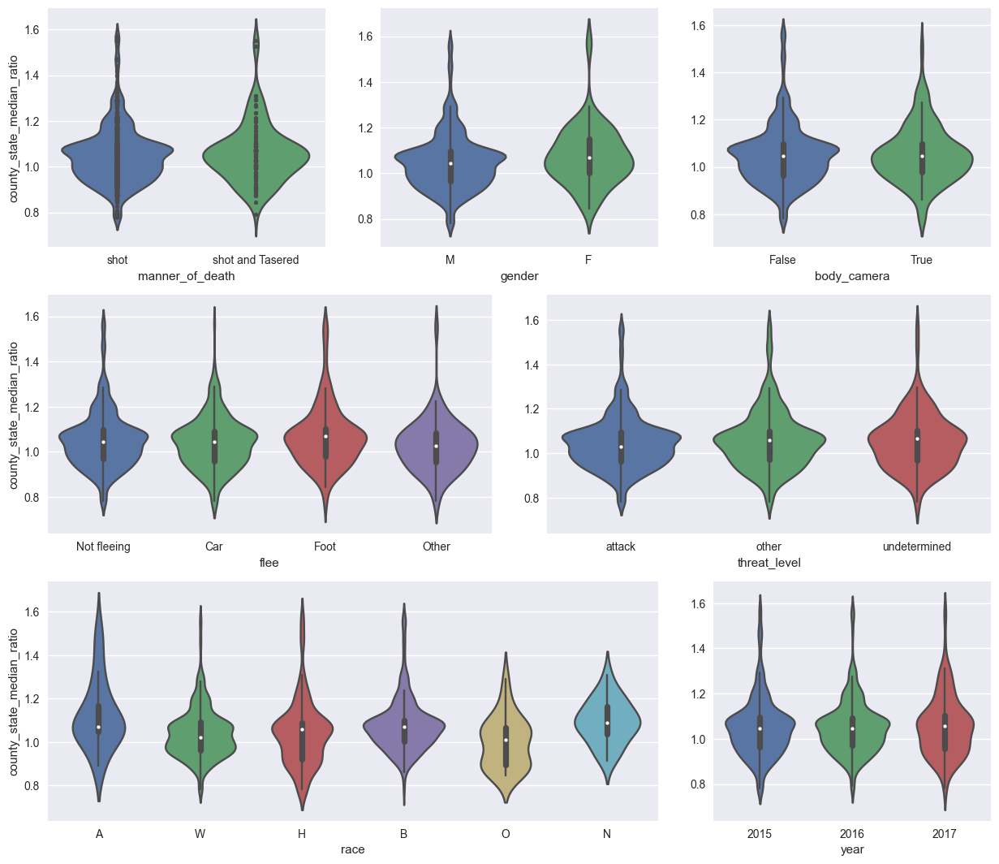

In [60]:
create_violin_plots('county_state_median_ratio')

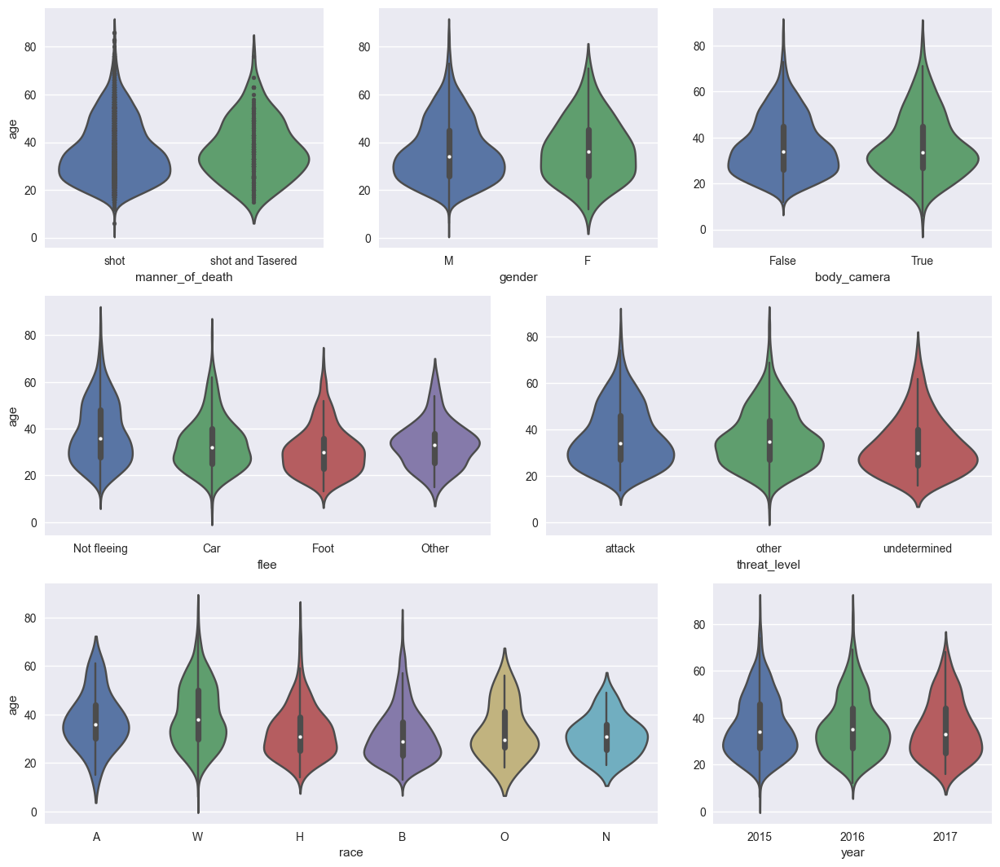

In [61]:
create_violin_plots('age')

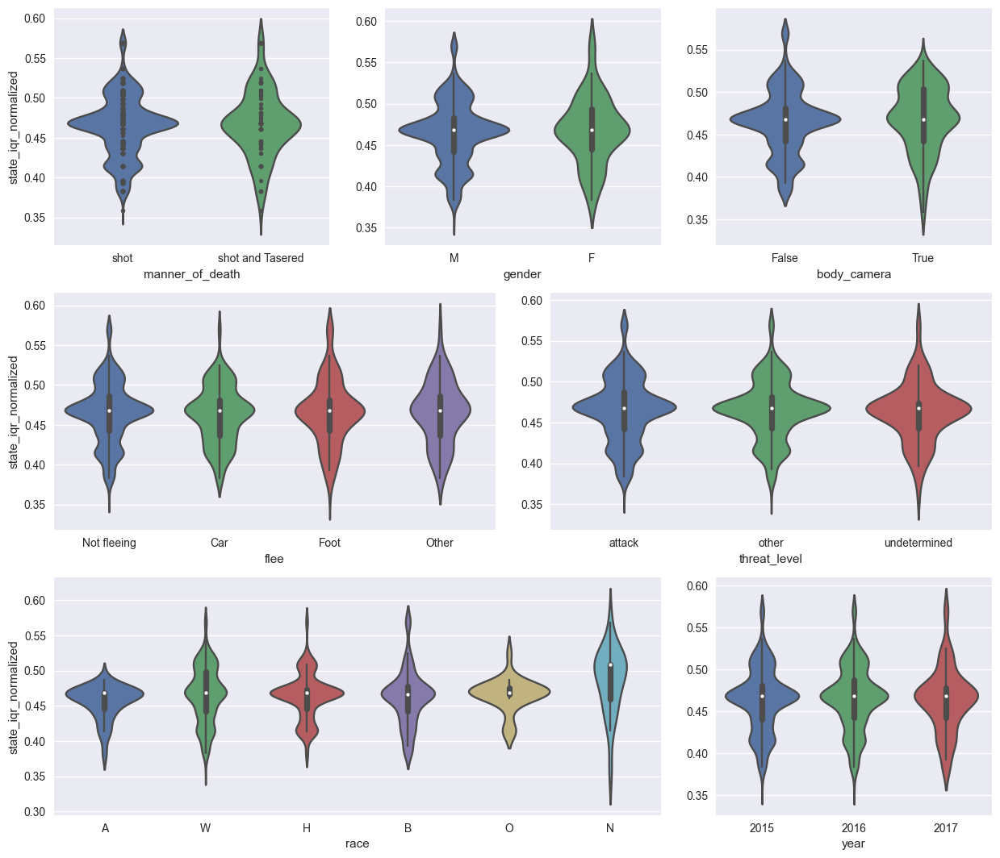

In [62]:
create_violin_plots('state_iqr_normalized')

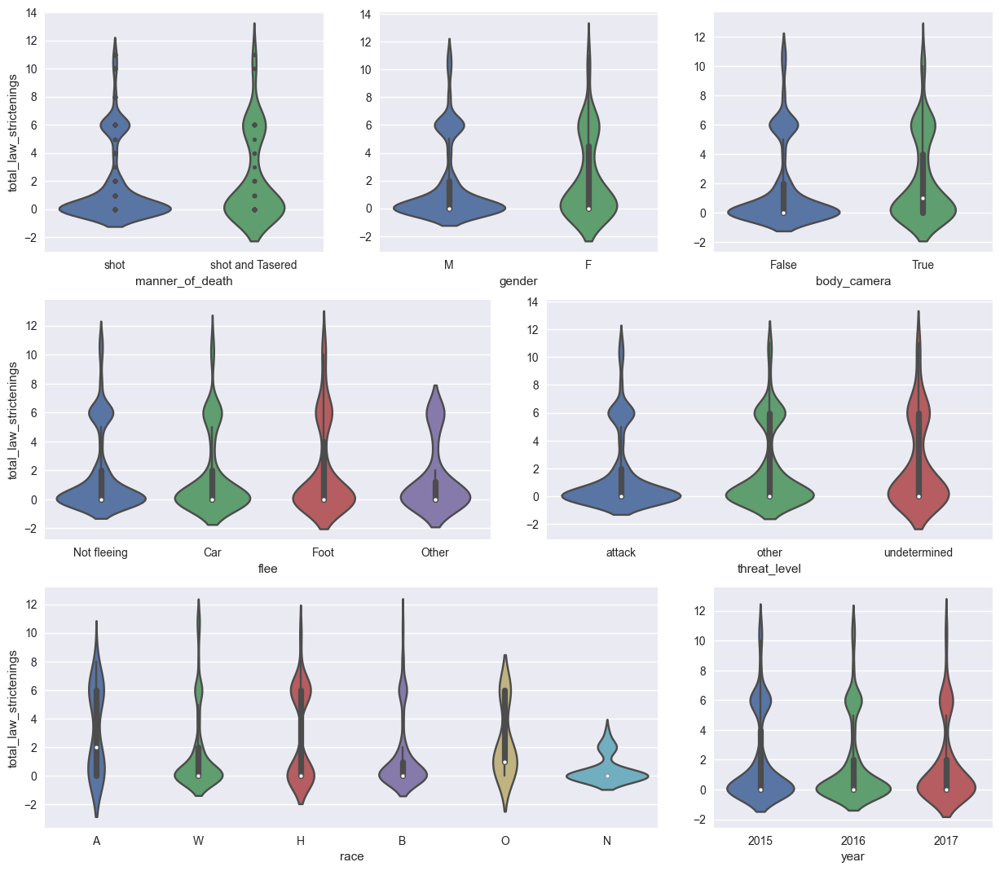

In [63]:
create_violin_plots('total_law_strictenings')

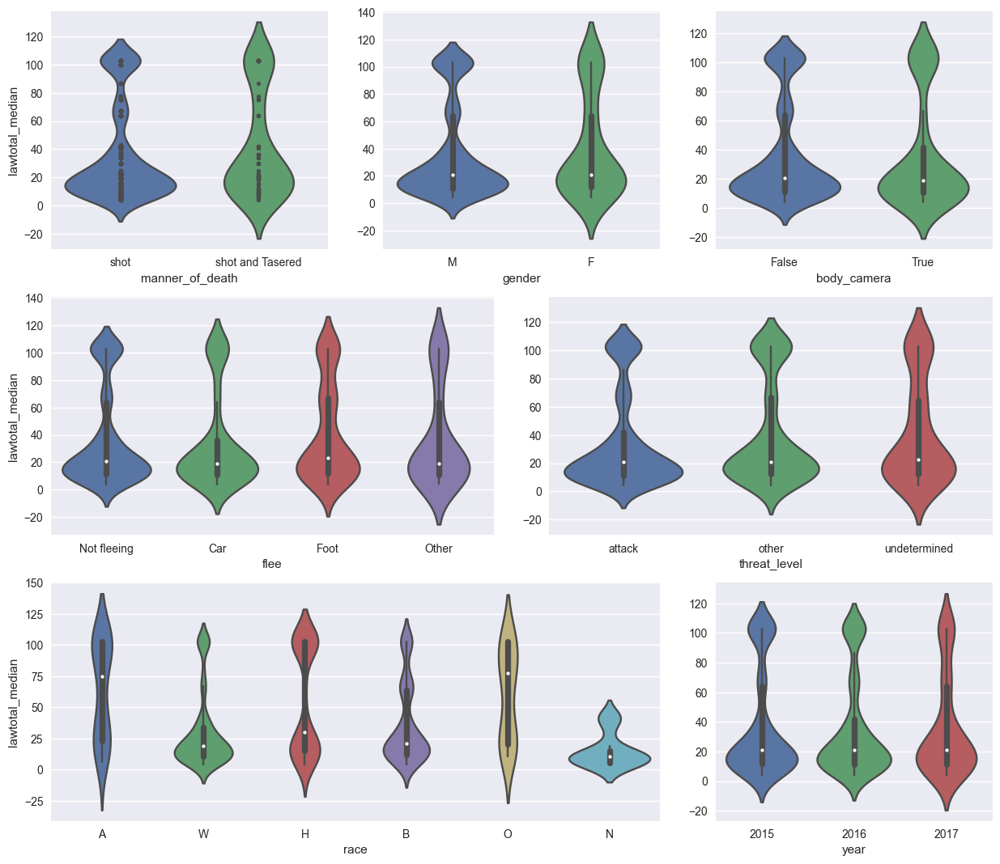

In [64]:
create_violin_plots('lawtotal_median')

In [65]:
create_geo_scatter('density', 'threat_level')

In [66]:
create_geo_scatter('age', 'race')

In [67]:
create_geo_scatter('county_iqr_normalized', 'signs_of_mental_illness')

In [68]:
create_geo_scatter('county_iqr_normalized', 'gender')

In [69]:
create_geo_scatter('county_state_median_ratio', 'gender')